<font size = 6> Прогнозирование оттока клиентов фитнес-центра </font> 

## Описание проекта

<div class="text-justify">  Проблемой многих компаний становится отток клиентов, не исключение и фитнес-клубы. Аналитические данные и их анализ могут помочь оптимизировать стратегию взаимодействия с клиентами, чтобы понять причины оттока и сократить отток. Для компании важно понять, по каким признакам можно понять, что скоро случится отток, так как не всегда клиенты просто закрыл договор или удалил аккаунт. Важно понять индикаторы оттока, при этом важно понимать, что они могут также зависеть от специфики отрасли. Например, интернет-магазин может быть уверен, что клиент не уходит в отток, если закупается регулярно. А в случае, если он не заходит на регулярно обновляющийся сайт в течение двух недель, то можно прогнозировать отток. </div>


<div class="text-justify">  Спецификой фитнес-центров можно считать следующий признак оттока: клиент не ходил в спортзал в течение последнего месяца. В некоторых случаях можно предположить, что клиент уехал в отпуск и вернется, но чаще всего это означает отток. </div>

Итак, фитнес-клуб подготовил данные о клиентах с целью прогнозирования оттока пользователей.
Цель исследования - проанализировать данные и разработать рекомендации снижения оттока клиентов.

Задачи исследования:
* построить прогноз вероятность оттока (на уровне следующего месяца) для каждого клиента;
* провести кластеризацию, а именно: сформировать типичные портреты клиентов: выделить несколько наиболее ярких групп и охарактеризовать их основные свойства;
* проанализировать основные признаки, наиболее сильно влияющие на отток;
* сформулировать основные выводы и разработать рекомендации по повышению качества работы с клиентами:
*1) выделить целевые группы клиентов;
*2) предложить меры по снижению оттока;
*3) определить другие особенности взаимодействия с клиентами.

In [52]:
import pandas as pd
import datetime as dt
import numpy as np
import itertools
import requests
import re
import math
from io import BytesIO
import scipy.stats as stats
from statsmodels.stats.multitest import multipletests

import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
from plotly import graph_objects as go

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

from sklearn.preprocessing import StandardScaler
from scipy.cluster.hierarchy import dendrogram, linkage 
from sklearn.cluster import KMeans
#from clustergram import Clustergram
#import urbangrammar_graphics as ugg
from sklearn.preprocessing import scale
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import MinMaxScaler

pd.set_option('display.float_format', '{:,.2f}'.format) #настройки pandas для отображения чисел без лишних запятых
pd.set_option("max_colwidth", 200) #настройки pandas для отображения строк полностью

## Описание данных

Фитнес-центр предоставил сведения в csv-файлах. Заказчик подготовил данные, которые содержат данные на месяц до оттока и факт оттока на определённый месяц.

In [53]:
try:
    # данные с сервера
    data = pd.read_csv('/datasets/gym_churn.csv')
except:
    # данные локально
    data = pd.read_csv('D:/gym_churn.csv')    

In [54]:
data.head()

,gender,Near_Location,Partner,Promo_friends,Phone,Contract_period,Group_visits,Age,Avg_additional_charges_total,Month_to_end_contract,Lifetime,Avg_class_frequency_total,Avg_class_frequency_current_month,Churn
0,1,1,1,1,0,6,1,29,14.23,5.00,3,0.02,0.00,0
1,0,1,0,0,1,12,1,31,113.20,12.00,7,1.92,1.91,0
2,0,1,1,0,1,1,0,28,129.45,1.00,2,1.86,1.74,0
3,0,1,1,1,1,12,1,33,62.67,12.00,2,3.21,3.36,0
4,1,1,1,1,1,1,0,26,198.36,1.00,3,1.11,1.12,0


Данные клиента за предыдущий до проверки факта оттока месяц:
* **'gender'** — пол;
* **'Near_Location'** — проживание или работа в районе, где находится фитнес-центр;
* **'Partner'** — сотрудник компании-партнёра клуба (сотрудничество с компаниями, чьи сотрудники могут получать скидки на абонемент — в таком случае фитнес-центр хранит информацию о работодателе клиента);
* **Promo_friends** — факт первоначальной записи в рамках акции «приведи друга» (использовал промо-код от знакомого при оплате первого абонемента);
* **'Phone'** — наличие контактного телефона;
* **'Age'** — возраст;
* **'Lifetime'** — время с момента первого обращения в фитнес-центр (в месяцах).

Информация на основе журнала посещений, покупок и информация о текущем статусе абонемента клиента:
* **'Contract_period'** — длительность текущего действующего абонемента (месяц, 6 месяцев, год);
* **'Month_to_end_contract'** — срок до окончания текущего действующего абонемента (в месяцах);
* **'Group_visits'** — факт посещения групповых занятий;
* **'Avg_class_frequency_total'** — средняя частота посещений в неделю за все время с начала действия абонемента;
* **'Avg_class_frequency_current_month'** — средняя частота посещений в неделю за предыдущий месяц;
* **'Avg_additional_charges_total'** — суммарная выручка от других услуг фитнес-центра: кафе, спорттовары, косметический и массажный салон.
* **'Churn'** — факт оттока в текущем месяце.

In [55]:
def to_snake_case(name):
    name = re.sub('(.)([A-Z][a-z]+)', r'\1_\2', name)
    name = re.sub('__([A-Z])', r'_\1', name)
    name = re.sub('([a-z0-9])([A-Z])', r'\1_\2', name)
    return name.lower()

In [56]:
def preprocess_data(data, snake_case):
    if snake_case == True:
        snake_case_columns = []
        for column in data.columns:
            snake_case_columns.append(to_snake_case(column))
        data.columns = snake_case_columns
    
    print('\033[1m' + 'Info:' + '\033[0m')
    data.info()
    
    print('\033[1m' + 'Head:' + '\033[0m')
    display(data.head())
    
    print('\033[1m' + 'Shape:' + '\033[0m')
    
    display(data.shape)
    #display('Number of dublicated values')
    
    print('\033[1m' + 'Number of dublicated values:' + '\033[0m')
    display(data.duplicated().sum())  

In [57]:
preprocess_data(data, True)

Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4000 entries, 0 to 3999
Data columns (total 14 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   gender                             4000 non-null   int64  
 1   near_location                      4000 non-null   int64  
 2   partner                            4000 non-null   int64  
 3   promo_friends                      4000 non-null   int64  
 4   phone                              4000 non-null   int64  
 5   contract_period                    4000 non-null   int64  
 6   group_visits                       4000 non-null   int64  
 7   age                                4000 non-null   int64  
 8   avg_additional_charges_total       4000 non-null   float64
 9   month_to_end_contract              4000 non-null   float64
 10  lifetime                           4000 non-null   int64  
 11  avg_class_frequency_total          4000 non-null  

,gender,near_location,partner,promo_friends,phone,contract_period,group_visits,age,avg_additional_charges_total,month_to_end_contract,lifetime,avg_class_frequency_total,avg_class_frequency_current_month,churn
0,1,1,1,1,0,6,1,29,14.23,5.00,3,0.02,0.00,0
1,0,1,0,0,1,12,1,31,113.20,12.00,7,1.92,1.91,0
2,0,1,1,0,1,1,0,28,129.45,1.00,2,1.86,1.74,0
3,0,1,1,1,1,12,1,33,62.67,12.00,2,3.21,3.36,0
4,1,1,1,1,1,1,0,26,198.36,1.00,3,1.11,1.12,0


Shape:


(4000, 14)

Number of dublicated values:


0

Из информации выше видно, что в датасете нет пропущенных значений и дубликтов. Типы данных также являются верными и не нуждаются в предварительной обработке.

## Исследовательский анализ данных (EDA)

### Описательные статистики признаков

Рассмотрим описательные статистики данных проекта.

In [58]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
gender,"4,000.00",0.51,0.50,0.00,0.00,1.00,1.00,1.00
near_location,"4,000.00",0.85,0.36,0.00,1.00,1.00,1.00,1.00
partner,"4,000.00",0.49,0.50,0.00,0.00,0.00,1.00,1.00
promo_friends,"4,000.00",0.31,0.46,0.00,0.00,0.00,1.00,1.00
phone,"4,000.00",0.90,0.30,0.00,1.00,1.00,1.00,1.00
contract_period,"4,000.00",4.68,4.55,1.00,1.00,1.00,6.00,12.00
group_visits,"4,000.00",0.41,0.49,0.00,0.00,0.00,1.00,1.00
age,"4,000.00",29.18,3.26,18.00,27.00,29.00,31.00,41.00
avg_additional_charges_total,"4,000.00",146.94,96.36,0.15,68.87,136.22,210.95,552.59
month_to_end_contract,"4,000.00",4.32,4.19,1.00,1.00,1.00,6.00,12.00


Из описательных статистик видно, что датасет по признаку пола разбит примерно одинаково. Больше клиентов (85%) проживают недалеко от фитнес-центра. Почти половина клиентов являются сотрудниками компании-партнера фитнес-клуба. Из всех клиентов 31% пришел по акции "Приведи друга". Телефон указали 90% пользователей. Средний лайфтайм клиента - 3.72 месяца. 

Средняя длительность абонемента - 4.68 месяца. Средний срок до окончания абонемента - 4.32 месяца. Из всех клиентов 41% посещает групповые занятия. Средняя частота посещений в неделю за все время действия абонемента по всем клиентам - 1.88, аналогичный показатель за предыдущий месяц - 1.77. Средняя суммарная выручка от других услуг фитнес-центра - 146.94 (от 0.15 до 552.59). Согласно данным, 27% клиентов ушли в отток.

In [59]:
data.query('churn == 0').describe().T

,count,mean,std,min,25%,50%,75%,max
gender,"2,939.00",0.51,0.50,0.00,0.00,1.00,1.00,1.00
near_location,"2,939.00",0.87,0.33,0.00,1.00,1.00,1.00,1.00
partner,"2,939.00",0.53,0.50,0.00,0.00,1.00,1.00,1.00
promo_friends,"2,939.00",0.35,0.48,0.00,0.00,0.00,1.00,1.00
phone,"2,939.00",0.90,0.30,0.00,1.00,1.00,1.00,1.00
contract_period,"2,939.00",5.75,4.72,1.00,1.00,6.00,12.00,12.00
group_visits,"2,939.00",0.46,0.50,0.00,0.00,0.00,1.00,1.00
age,"2,939.00",29.98,3.01,19.00,28.00,30.00,32.00,41.00
avg_additional_charges_total,"2,939.00",158.45,99.80,0.17,76.92,149.88,224.45,552.59
month_to_end_contract,"2,939.00",5.28,4.36,1.00,1.00,6.00,10.00,12.00


In [60]:
data.query('churn == 1').describe().T

,count,mean,std,min,25%,50%,75%,max
gender,"1,061.00",0.51,0.50,0.00,0.00,1.00,1.00,1.00
near_location,"1,061.00",0.77,0.42,0.00,1.00,1.00,1.00,1.00
partner,"1,061.00",0.36,0.48,0.00,0.00,0.00,1.00,1.00
promo_friends,"1,061.00",0.18,0.39,0.00,0.00,0.00,0.00,1.00
phone,"1,061.00",0.90,0.30,0.00,1.00,1.00,1.00,1.00
contract_period,"1,061.00",1.73,2.13,1.00,1.00,1.00,1.00,12.00
group_visits,"1,061.00",0.27,0.44,0.00,0.00,0.00,1.00,1.00
age,"1,061.00",26.99,2.90,18.00,25.00,27.00,29.00,38.00
avg_additional_charges_total,"1,061.00",115.08,77.70,0.15,50.63,103.81,165.62,425.54
month_to_end_contract,"1,061.00",1.66,1.96,1.00,1.00,1.00,1.00,12.00


Количество клиентов в оттоке меньше, чем тех, кто остался. В целом, у клиентов в оттоке больше среднее расстояние от дома/работы до фитнес-центра, меньше длительность абонемента, меньше количество посещений групповых программ, а также средненедельных посещений центра как за последний месяц, так и за весь период действия абонента.

### Анализ средних значений признаков в разбивке по оттоку

Сгруппируем данные по столбцу 'churn', чтобы посмотреть средние значения признаков.

In [61]:
data_by_churn = data.groupby('churn').agg('mean')
data_by_churn.T

churn,0,1
gender,0.51,0.51
near_location,0.87,0.77
partner,0.53,0.36
promo_friends,0.35,0.18
phone,0.90,0.90
contract_period,5.75,1.73
group_visits,0.46,0.27
age,29.98,26.99
avg_additional_charges_total,158.45,115.08
month_to_end_contract,5.28,1.66


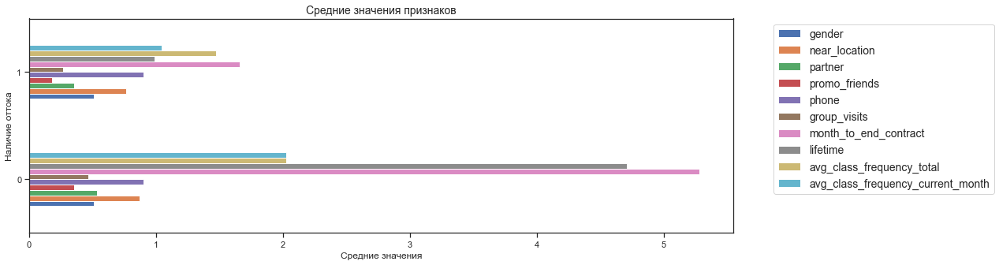

In [62]:
data_by_churn.drop(['avg_additional_charges_total', 'age', 'contract_period'], axis = 1).plot(kind='barh', figsize = (16, 5))

plt.title('Средние значения признаков', fontsize = 14)
plt.xlabel('Средние значения', fontsize = 12)
plt.ylabel('Наличие оттока', fontsize = 12) 
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', fontsize = 14)
plt.show()

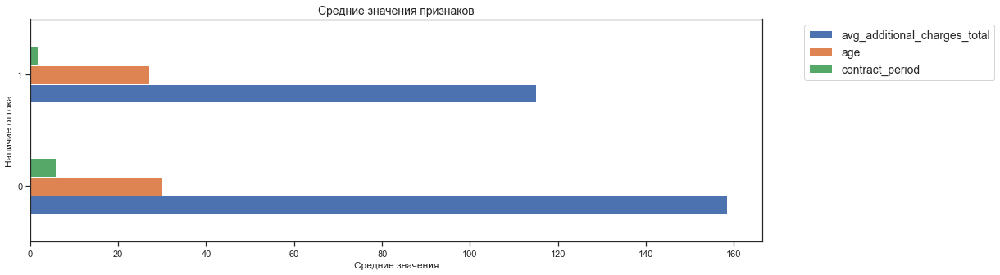

In [63]:
data_by_churn[['avg_additional_charges_total', 'age', 'contract_period']].plot(kind='barh', figsize = (16, 5))

plt.title('Средние значения признаков', fontsize = 14)
plt.xlabel('Средние значения', fontsize = 12)
plt.ylabel('Наличие оттока', fontsize = 12) 
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', fontsize = 14)
plt.show()

Из полученных данных видим, что пол не влияет на отток, также не влияет указание телефона, есть незначительное влияние возрасте (средний возраст 29.98 - в группе без оттока, и 26.99 - в группе с оттоком. 
Средние значения отличаются по следюущим признакам:
* расположение дома/ работы вблизи фитнес-центра - отток выше среди тех клиентов, у кого выше расстояние до фитнес-центра;
* среди клиентов-сотрудников компаний партнеров фитнес-клуба фактов оттока меньше,
* меньше оттока среди тех, кто пришел по акции "приведи друга",
* в группе без оттока длительность абонемента 5.75, с оттоком - 1.73, т.е. клиенты, приобретающие длительный абоменет, менее склонны к оттоку,
* в группе с оттоком меньше среднее количество групповых посещений - 27% против 46% не склонных к оттоку,
* в группе с оттоком меньше средняя выручка от доп. услуг - 115.08 против 158.45 среди несклонных к оттоку,
* средний срок окончания действия абонемента выше у тех, кто не пошел в отток, - 5.28, у склонных к оттоку этот показатель равен 1.66 месяца,
* средний лайфтайм в группе без оттока 4.71, в группе с оттоком - 0.99,
* средняя посещаемость за весь срок 2.02 раза в неделю в группе без оттока против 1.47 в группе с оттоком, и за последний месяц она в два раза выше в группе без оттока - 2.03 против 1.04.

### Столбчатые гистограммы и распределения признаков для тех, кто ушёл (отток) и тех, кто остался (не попали в отток)

Построим столбчатые диаграммы в разбивке по факту оттока.

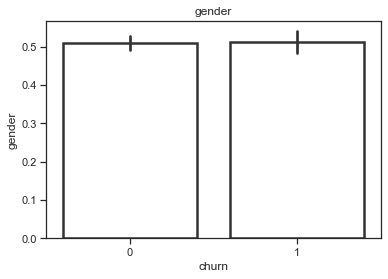

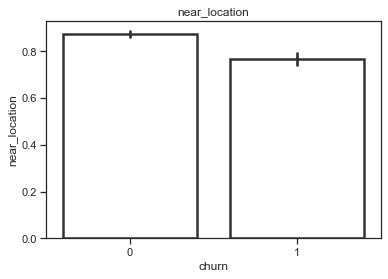

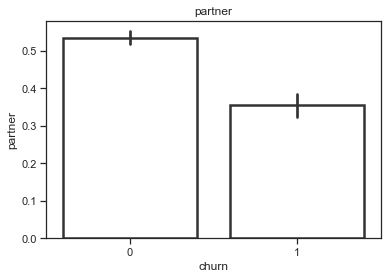

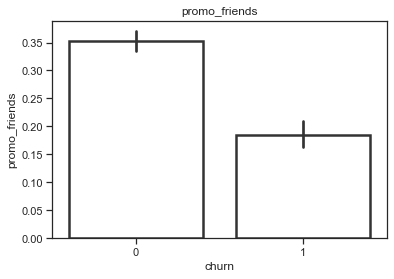

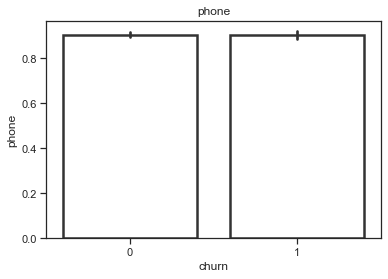

...

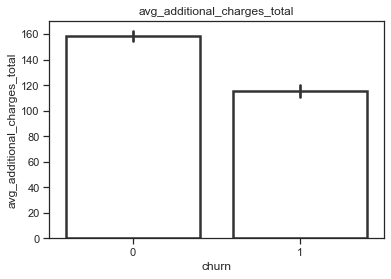

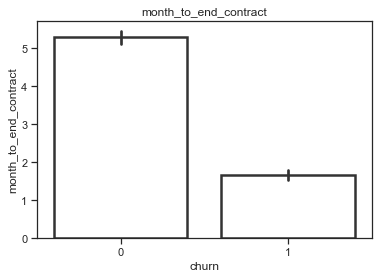

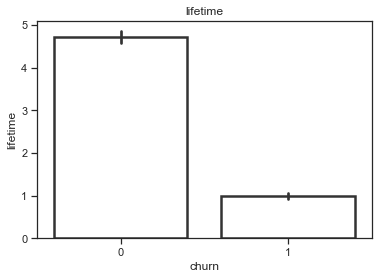

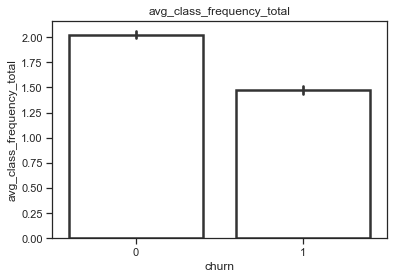

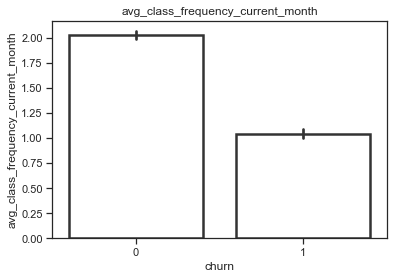

In [64]:
for col in data.columns[:-1]:
    sns.barplot(x='churn', y=col, data=data,
               linewidth=2.5, facecolor=(1, 1, 1, 0),
                 errcolor=".2", edgecolor=".2"
               )
            
    plt.title(col)
    plt.show()

Столбчатые диаграммы наглядно демонстрируют полученные выше выводы о разнице в показателях между группой клиентов, которые ушли в отток и группой клиентов, оставшихся в фитнес-клубе (не ушедших в отток).

Построим диаграммы распределения признаков в разбивке по факту ухода в отток.

In [65]:
def plot_dist(column):
    ax = sns.displot(data=data,
                     x=column, 
                     kind="kde", 
                     height=6,
                     aspect=2,
                     hue="churn",
                     #multiple="stack",
                     fill = True
                    )

    #ax.set_xticklabels(rotation = 30)
    plt.title(f"Distribution histogram of {column.name}")
   
    plt.show()

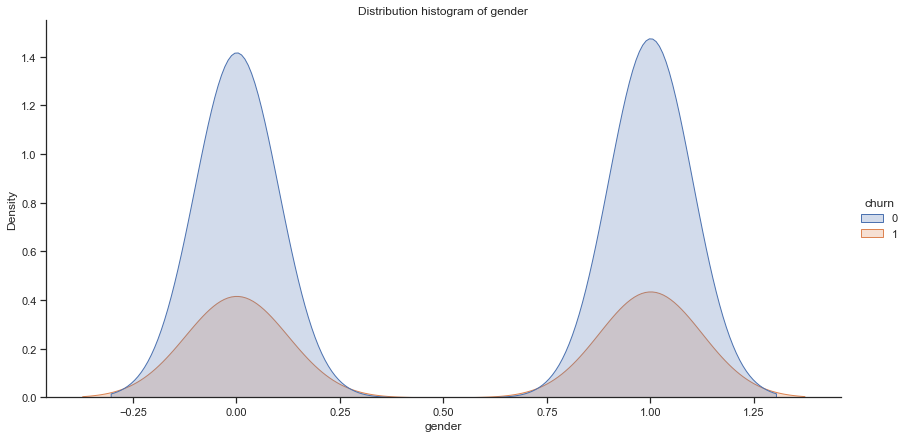

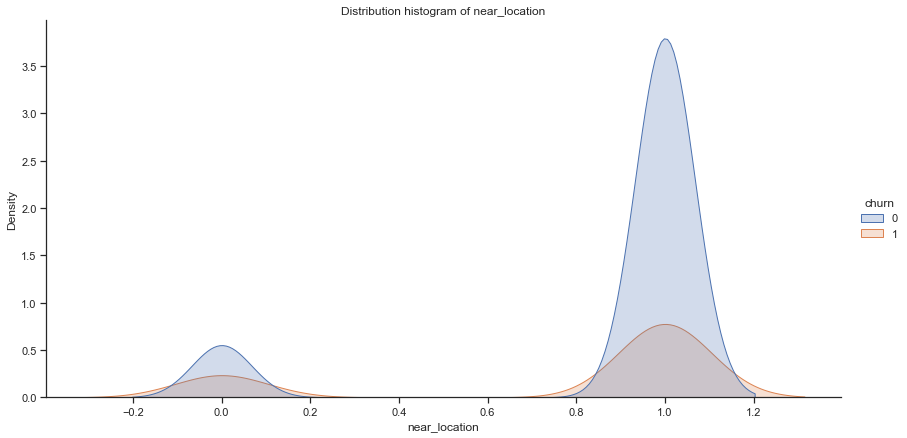

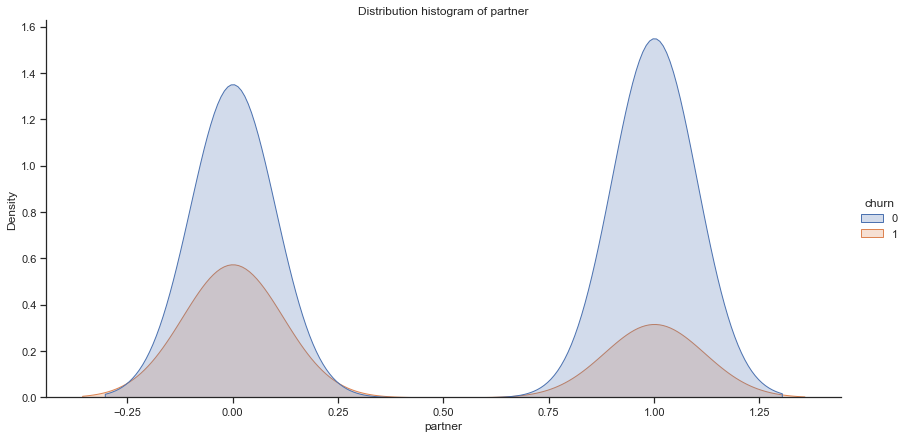

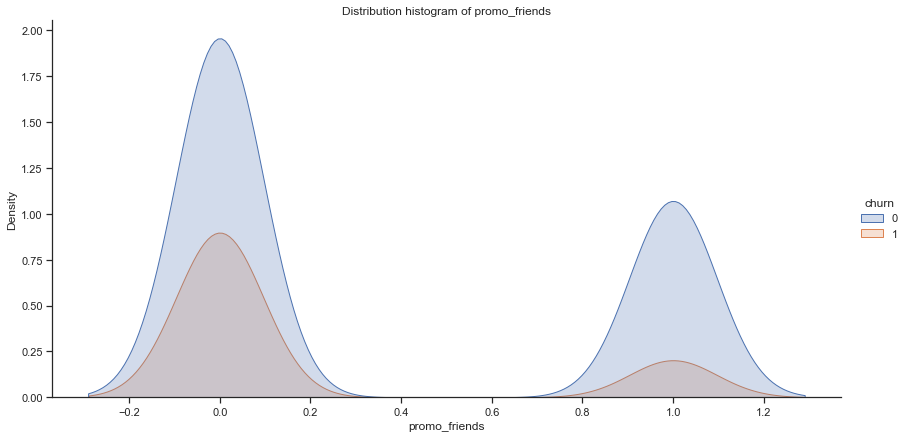

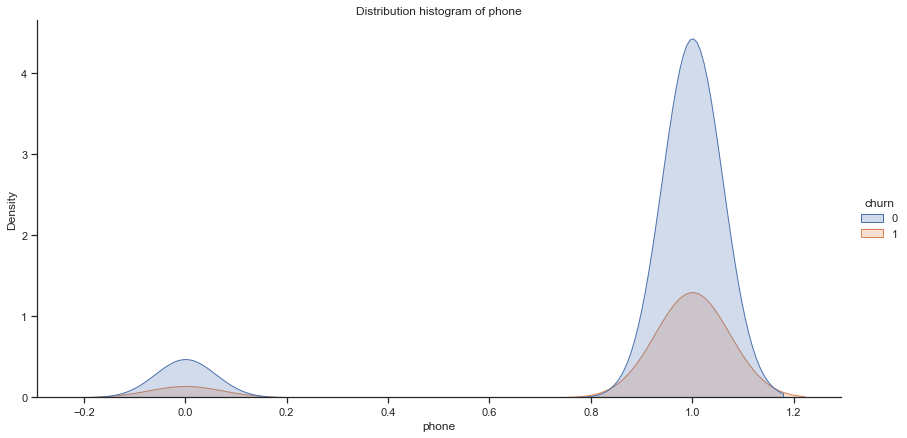

...

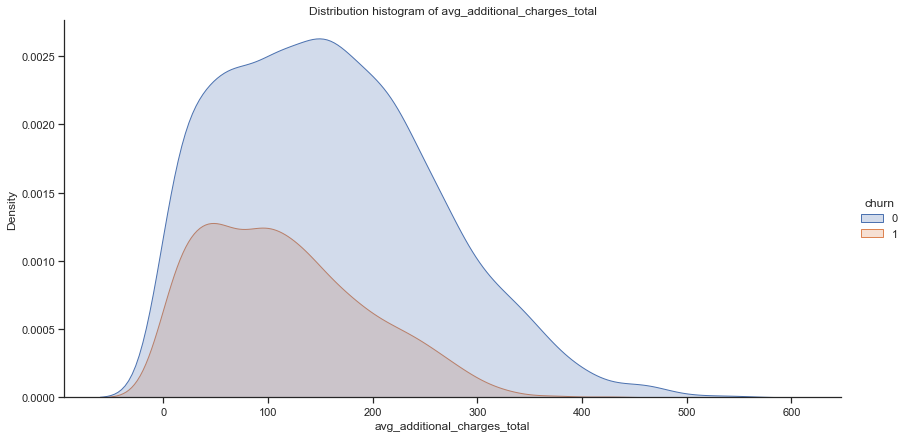

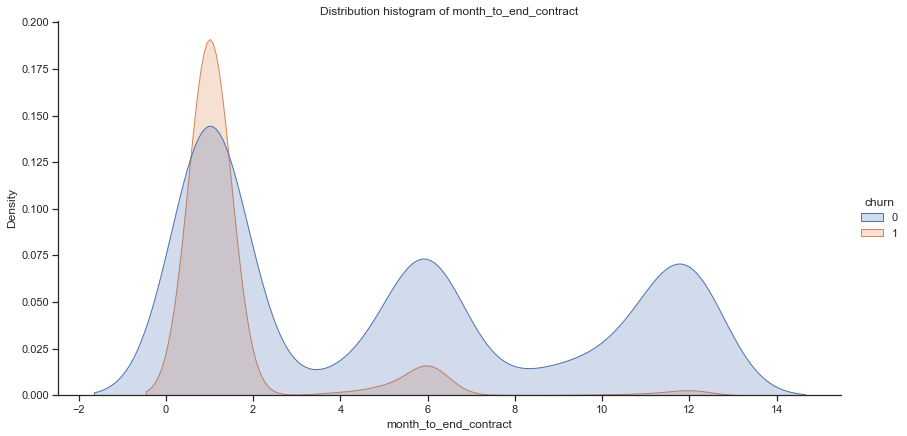

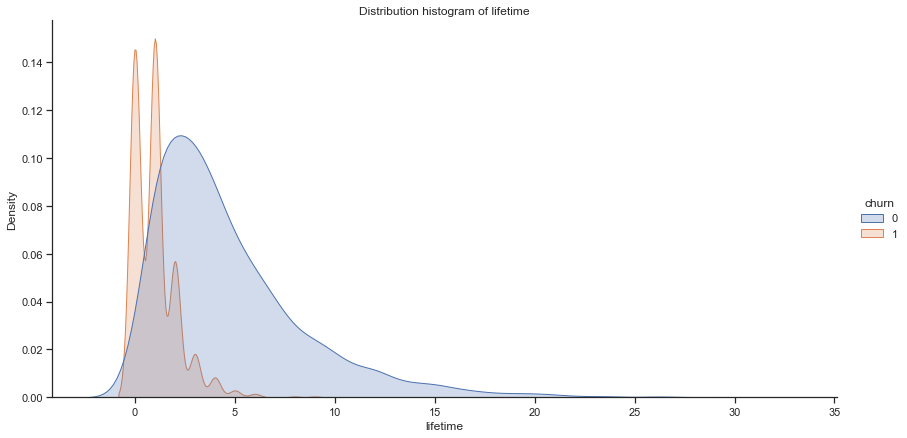

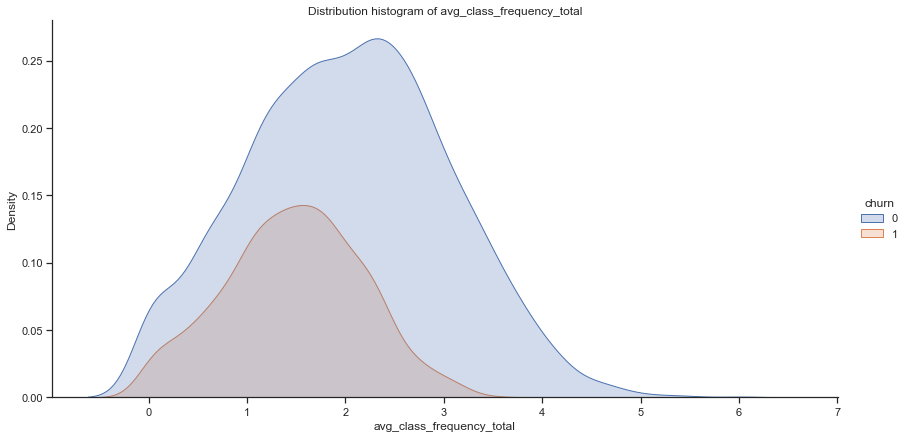

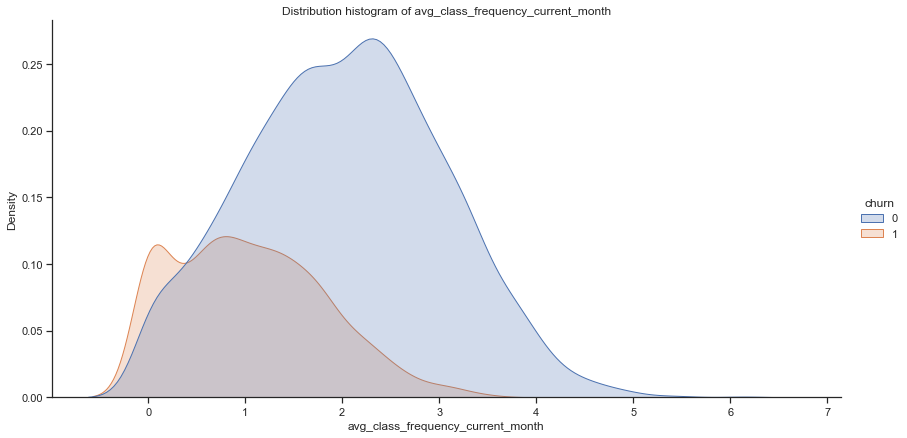

In [66]:
for col in data.columns[:-1]:
    plot_dist(data[col])

На полученных гистограммах четко видно разницу по показателям среди ушедших и не ушедших в отток.

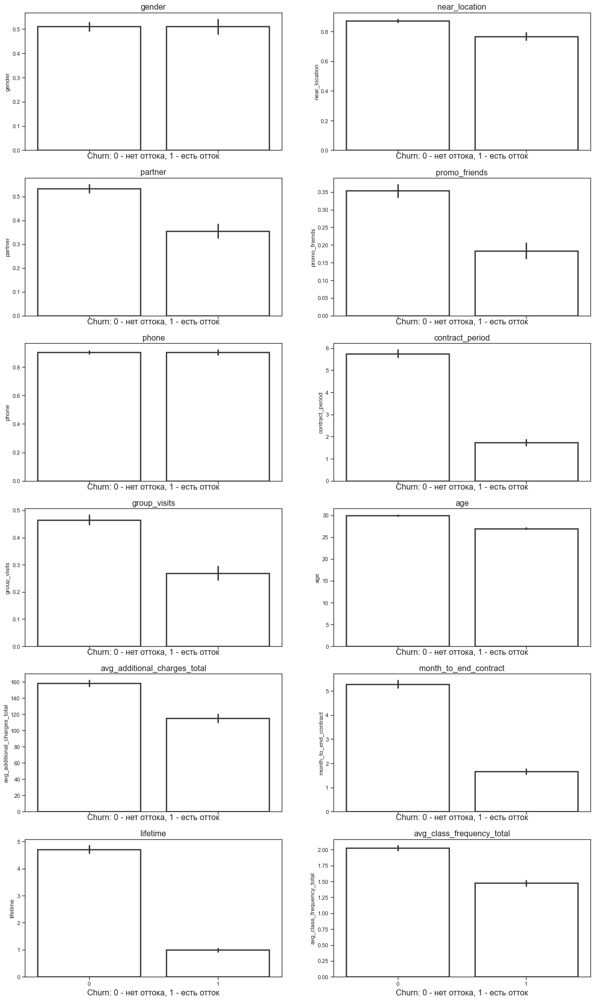

In [67]:
#define plotting region (number of rows, number of columns)
fig, axes = plt.subplots(6, 2, figsize=(20,35), sharex=True)

#create plot in each subplot
for index, column in enumerate(data.columns[:-2]):
    row = index // 2
    col = index % 2
    ax = sns.barplot(data=data, x='churn', y=column, ax=axes[row, col],
                     linewidth=2.5, facecolor=(1, 1, 1, 0),
                     errcolor=".2", edgecolor=".2")
    ax.set_title(column, fontsize=16)
    ax.set_xlabel('Churn: 0 - нет оттока, 1 - есть отток', fontsize=16)
plt.show()

Рассмотрим влияние признаков на отток более подробно.

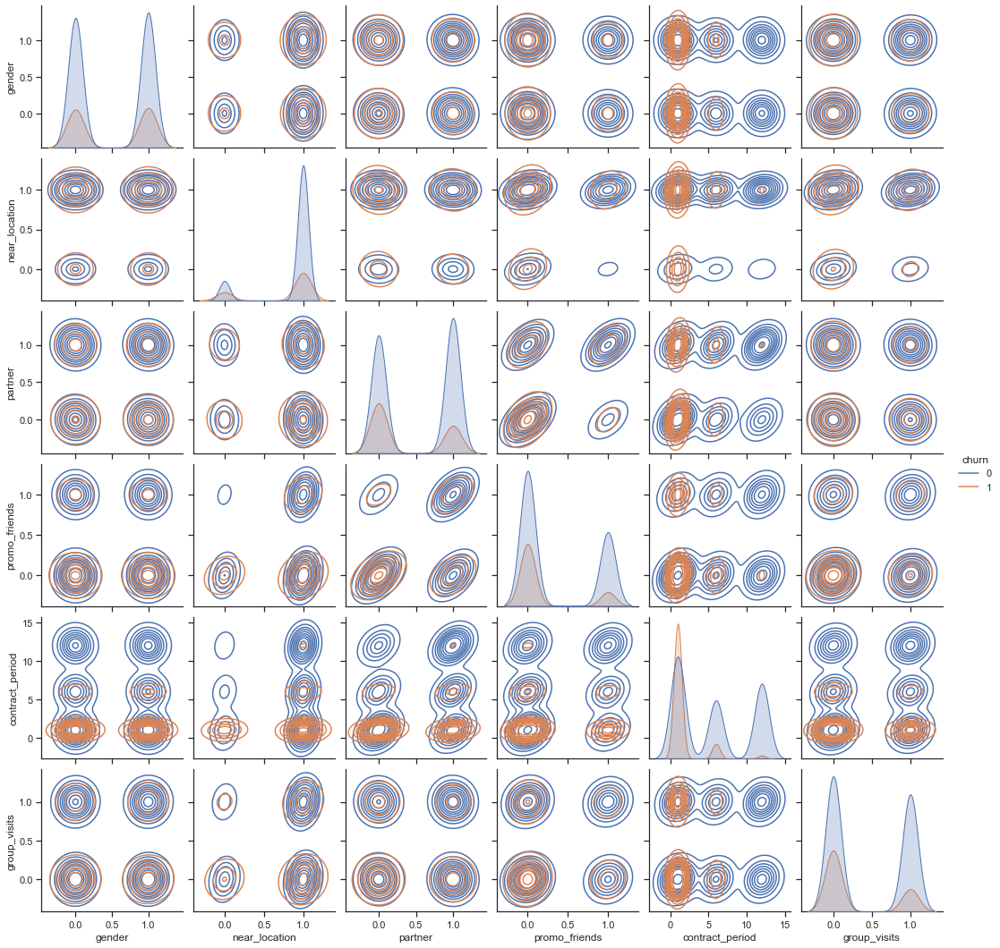

In [68]:
sns.set_theme(style="ticks")
sns.pairplot(data[['gender', 'near_location', 'partner', 'promo_friends',
               'contract_period',  'group_visits',
               'churn']], hue="churn",
             kind="kde")
plt.show()

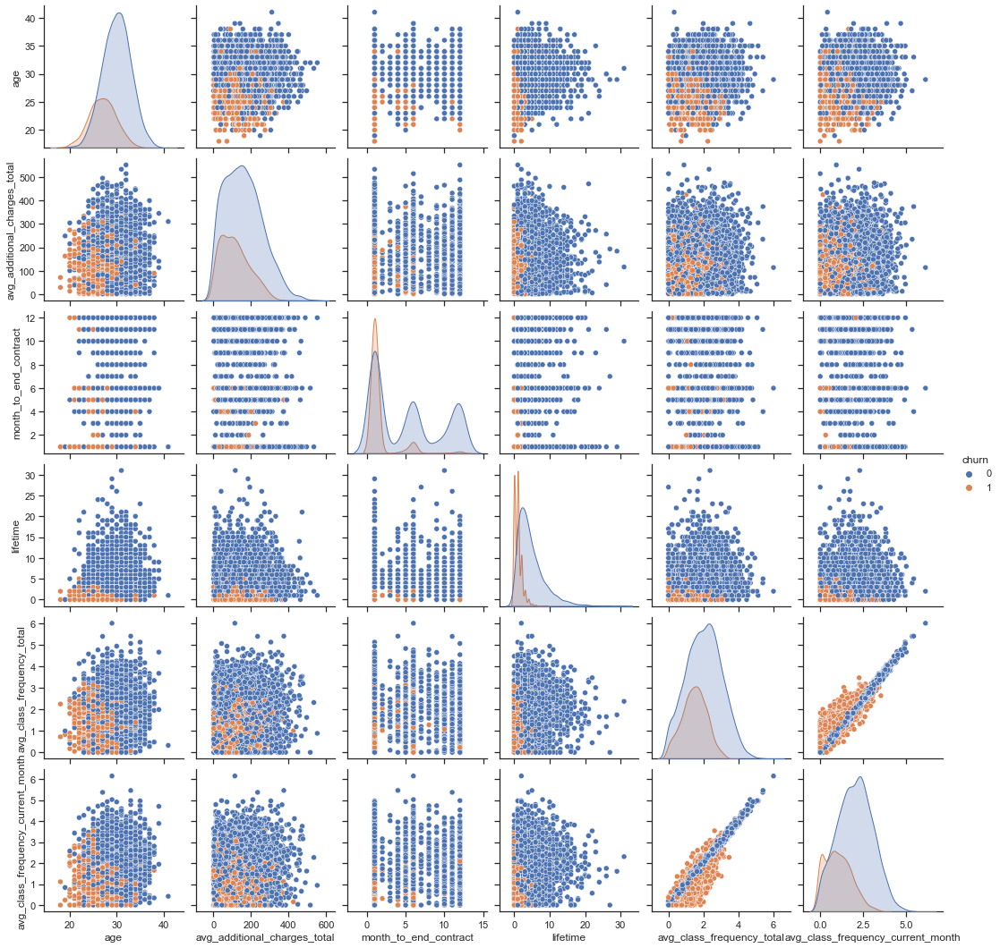

In [69]:
sns.set_theme(style="ticks")
sns.pairplot(data[['age', 'avg_additional_charges_total', 'month_to_end_contract', 'lifetime',
       'avg_class_frequency_total', 'avg_class_frequency_current_month', 'churn']], hue="churn")
plt.show()

Диаграмма показывает, что более молодые клиенты чаще уходят в отток, также, что ушедшие в отток приносят меньше дополнительной прибыли. Длительность абонемента у ушедших в отток короткая, они практически не покупают абонементы на длительный период. Также группа оттока демонстирует более низкую посещаемость.

### Корреляционная матрица

Построим корреляционную матрицу для нахождения зависимости между признаками.

In [70]:
corr_m = data.corr()

In [71]:
corr_m

,gender,near_location,partner,promo_friends,phone,contract_period,group_visits,age,avg_additional_charges_total,month_to_end_contract,lifetime,avg_class_frequency_total,avg_class_frequency_current_month,churn
gender,1.00,0.01,-0.01,-0.01,-0.01,0.00,0.02,0.01,-0.01,-0.00,0.01,0.01,0.01,0.00
near_location,0.01,1.00,-0.01,0.21,-0.02,0.15,0.15,0.06,0.04,0.14,0.07,0.04,0.06,-0.13
partner,-0.01,-0.01,1.00,0.45,0.01,0.31,0.02,0.05,0.02,0.29,0.06,0.02,0.05,-0.16
promo_friends,-0.01,0.21,0.45,1.00,0.00,0.24,0.12,0.05,0.04,0.24,0.07,0.03,0.05,-0.16
phone,-0.01,-0.02,0.01,0.00,1.00,-0.01,-0.01,-0.01,0.01,-0.01,-0.02,0.01,0.01,-0.00
contract_period,0.00,0.15,0.31,0.24,-0.01,1.00,0.17,0.14,0.11,0.97,0.17,0.10,0.16,-0.39
group_visits,0.02,0.15,0.02,0.12,-0.01,0.17,1.00,0.08,0.03,0.16,0.08,0.06,0.08,-0.18
age,0.01,0.06,0.05,0.05,-0.01,0.14,0.08,1.00,0.08,0.13,0.16,0.12,0.18,-0.40
avg_additional_charges_total,-0.01,0.04,0.02,0.04,0.01,0.11,0.03,0.08,1.00,0.11,0.08,0.04,0.08,-0.20
month_to_end_contract,-0.00,0.14,0.29,0.24,-0.01,0.97,0.16,0.13,0.11,1.00,0.16,0.09,0.15,-0.38


Визуализируем данные на тепловой карте.

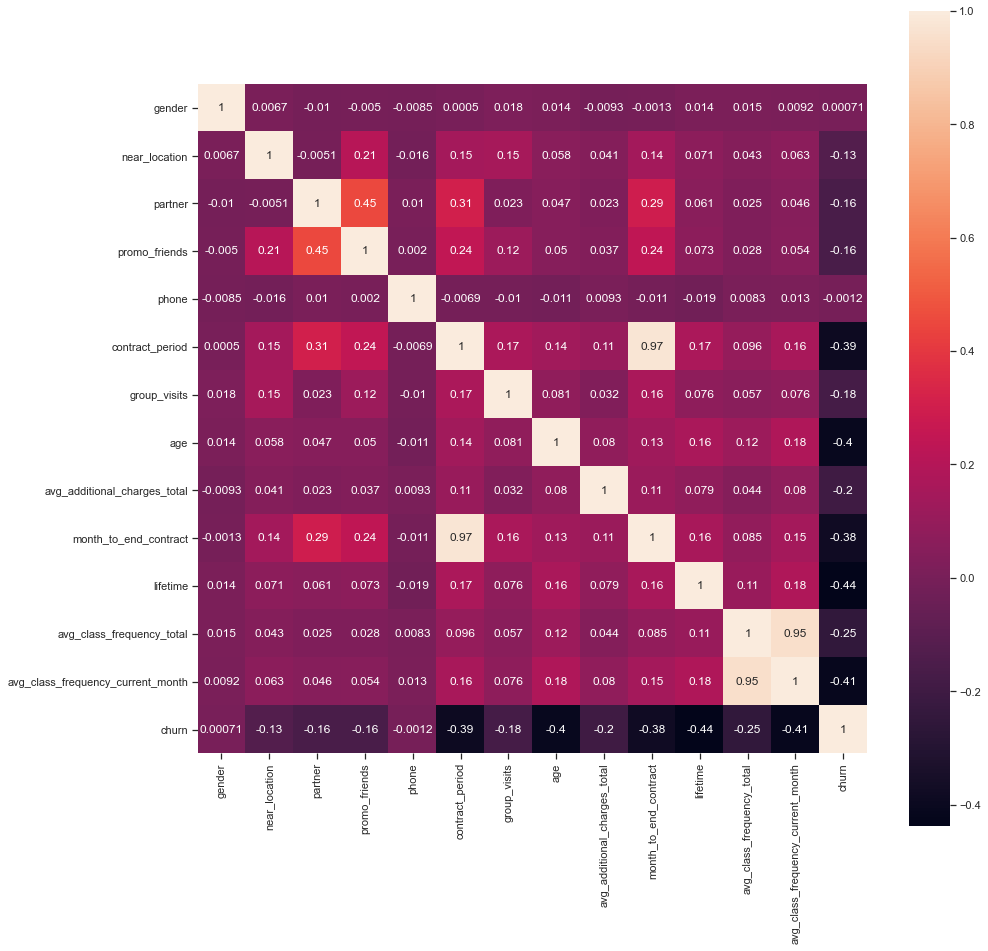

In [72]:
plt.figure(figsize = (15,15))
sns.heatmap(corr_m, 
        square = True, 
        annot = True)
plt.show()

Рассмотрим признаки, которые наиболее сильно влияют на отток клиентов фитнес-клуба. Близки по значению корреляции признаков promo_friends и partner (мультиколлениарность).

In [73]:
data = data.drop('partner', axis = 1)

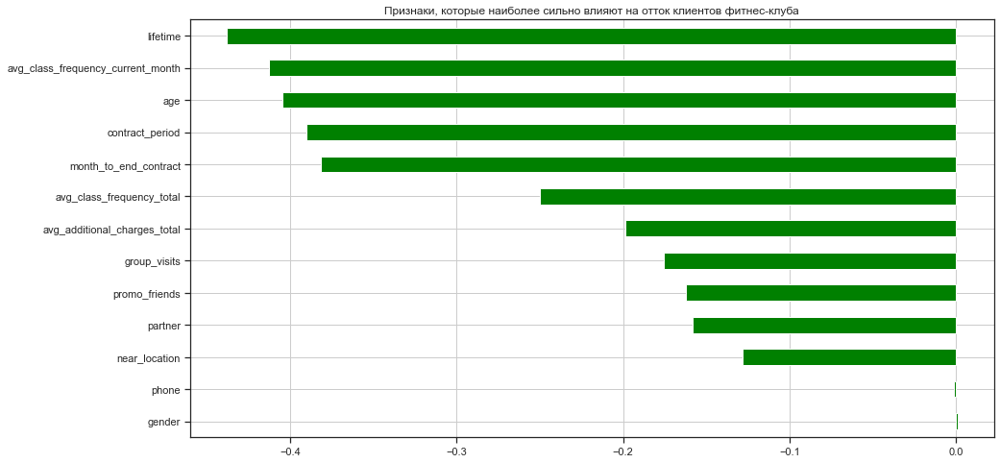

In [74]:
plt.figure(figsize=(15, 8))
corr_m.sort_values(by='churn', ascending=False)['churn'][1:].plot(kind='barh', color = 'green', grid=True)
plt.title('Признаки, которые наиболее сильно влияют на отток клиентов фитнес-клуба')
plt.show()

Данные показали, что наиболее сильно на отток влияет лайфтайм, количество посещений за последний месяц, возраст, длительность абонемента, количество месяцев до истечения абонемента и т.д. Совсем не влияет пол, указание телефона (почти нулевая корреляция).

Отразим наиболее влиятельные признаки на графике с помощью pairplot библиотеки seaborn.

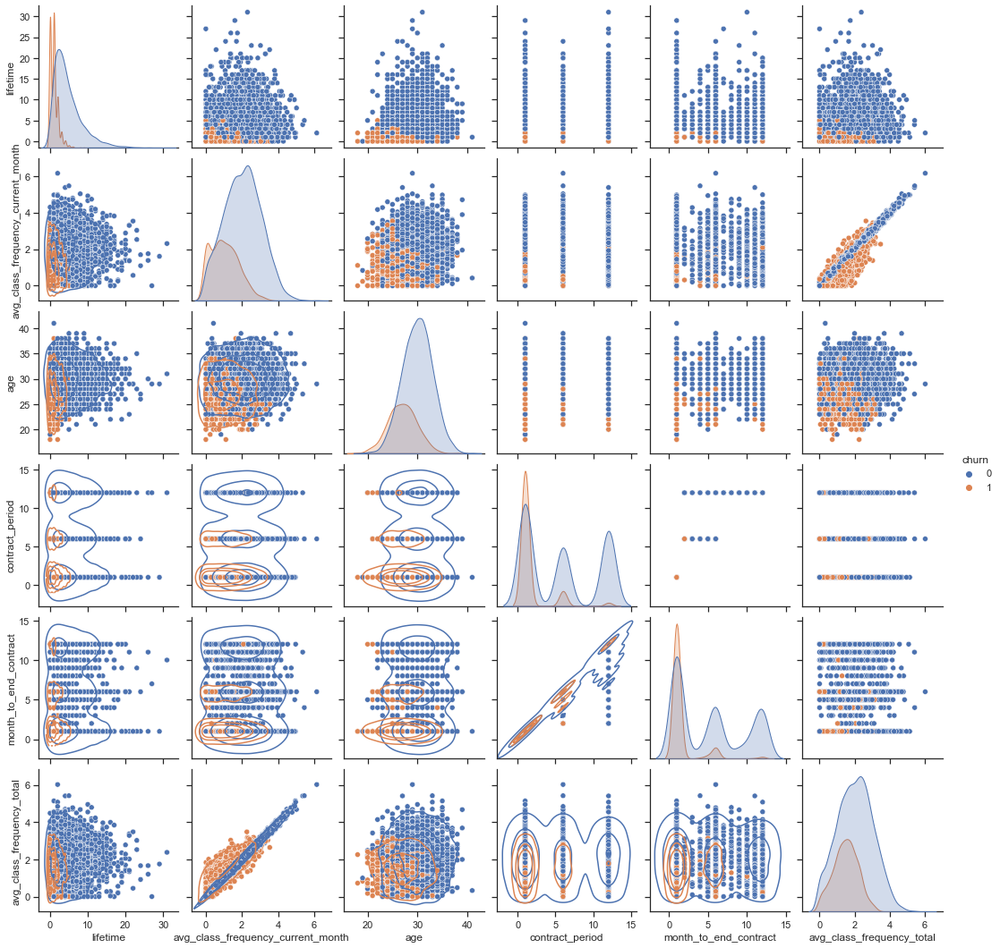

In [75]:
g = sns.pairplot(data[['lifetime', 
                   'avg_class_frequency_current_month',  
                   'age',
                   'contract_period',
                   'month_to_end_contract',
                   'avg_class_frequency_total',
                   'churn']], hue="churn", diag_kind="kde")

g.map_lower(sns.kdeplot, levels=4, color=".2")
plt.show()

У клиентов, которые остались в фитнес-клубе, более длительный лайфтайм, более высокая посещаемость занятий за последний месяц, выше возраст, более длительный срок абонемента, больше срок действия оставшегося абонемента.

## Модель прогнозирования оттока клиентов

Построим модель бинарной классификации клиентов, где целевой признак — факт оттока клиента в следующем месяце.

### Разделение данных на обучающую и валидационную выборку функцией train_test_split()

Разобьем данные на обучающую и валидационную выборку функцией train_test_split().

In [76]:
y = data['churn']

In [77]:
X = data.drop('churn', axis = 1)

In [78]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0, stratify=y)

Был использован атрибут `stratify`, в который помещена целевая переменная. Этот атрибут дает нам безопасность сохранения 20% значений равного нужного нам количества классов в целевой переменной. Параметр `random_state` дает возможность получать одни и те же результаты.

Итак, данные разделены. Размер обучающей выборки - 20%, размер валидационной (тестовой) выборки - 80%.

In [79]:
data_y = y.value_counts().to_frame().reset_index()
data_y_test = y_test.value_counts().to_frame().reset_index()
data_y_train = y_train.value_counts().to_frame().reset_index()

In [80]:
labels = ['нет оттока', 'есть отток']
colors = sns.color_palette('pastel')

fig = plt.figure(figsize=(25,10), dpi=800)

ax1 = plt.subplot2grid((1,3),(0,0))
plt.pie(data_y['churn'], autopct='%.0f%%', labels = labels, colors = colors)
plt.title('Баланс классов в общей выборке', fontsize = 20)

#next one
ax1 = plt.subplot2grid((1, 3), (0, 1))
plt.pie(data_y_train['churn'], autopct='%.0f%%', labels = labels, colors = colors)
plt.title('Баланс классов в обучающей выборке', fontsize = 20)

#next one
ax1 = plt.subplot2grid((1, 3), (0, 2))
plt.pie(data_y_test['churn'], autopct='%.0f%%', labels = labels, colors = colors)
plt.title('Баланс классов в валидационной выборке',  fontsize = 20)

plt.show()

Соотношение классов "0" и "1" в выборках составляет 73/27, 73/27, 74/26.

### Обучение модели на train-выборке двумя способами

#### Модель логистической регрессии

**Логистическая регрессия или логит-модель** (англ. logit model) — статистическая модель, используемая для прогнозирования вероятности возникновения некоторого события путём его сравнения с логистической кривой. Эта регрессия выдаёт ответ в виде вероятности бинарного события (1 или 0).

Зададим алгоритм для модели логистической регресии:

In [81]:
lr_model = LogisticRegression(solver='liblinear')

Обучим модель на train-выборке:

In [82]:
lr_model.fit(X_train, y_train)

LogisticRegression(solver='liblinear')

In [83]:
lr_model.get_params(deep=True)

{'C': 1.0,
 'class_weight': None,
 'dual': False,
 'fit_intercept': True,
 'intercept_scaling': 1,
 'l1_ratio': None,
 'max_iter': 100,
 'multi_class': 'auto',
 'n_jobs': None,
 'penalty': 'l2',
 'random_state': None,
 'solver': 'liblinear',
 'tol': 0.0001,
 'verbose': 0,
 'warm_start': False}

Воспользуемся обученной моделью, чтобы сделать прогнозы:

In [84]:
lr_predictions = lr_model.predict(X_test)
lr_probabilities = lr_model.predict_proba(X_test)[:,1]

Рассмотрим прогнозы более внимательно.

In [85]:
lr_data = X_test.copy()
lr_data['predictions'] = lr_predictions
lr_data['probabilities'] = lr_probabilities
lr_data

,gender,near_location,promo_friends,phone,contract_period,group_visits,age,avg_additional_charges_total,month_to_end_contract,lifetime,avg_class_frequency_total,avg_class_frequency_current_month,predictions,probabilities
3025,0,1,1,1,1,1,27,61.35,1.00,1,1.23,0.81,1,0.88
31,0,1,0,1,12,1,32,87.86,12.00,1,0.00,0.00,0,0.07
2017,1,1,0,1,12,1,25,243.13,12.00,4,1.02,0.94,0,0.01
55,0,1,1,0,1,0,30,194.67,1.00,4,1.89,1.90,0,0.02
2096,1,1,0,1,1,0,32,101.19,1.00,5,1.84,1.80,0,0.03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1224,1,1,0,1,1,1,31,281.63,1.00,0,2.28,2.18,0,0.37
3641,0,1,0,1,1,0,30,136.22,1.00,0,1.42,1.36,1,0.80
2520,1,1,0,1,12,0,30,248.19,12.00,5,1.87,1.83,0,0.00
3395,1,1,0,1,1,0,30,145.57,1.00,3,3.70,3.73,0,0.04


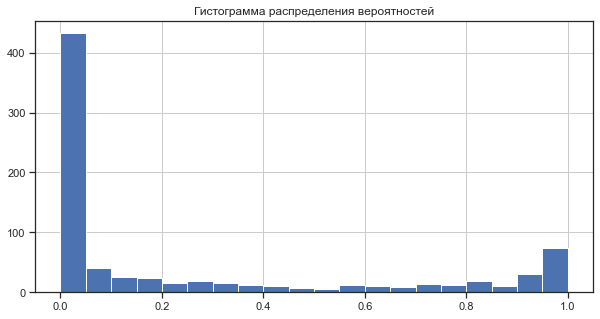

In [86]:
plt.figure(figsize=(10, 5))
lr_data['probabilities'].hist(bins=20)
plt.title('Гистограмма распределения вероятностей')
plt.show()

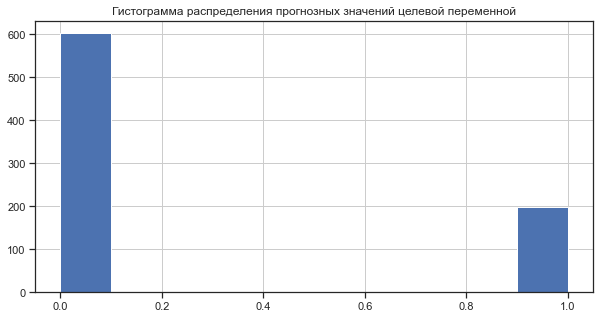

In [87]:
plt.figure(figsize=(10, 5))
lr_data['predictions'].hist()
plt.title('Гистограмма распределения прогнозных значений целевой переменной')
plt.show()

Можно визуализировать регрессионную зависимость с помощью функций библиотеки Seaborn regplot() и lmplot() с параметром logistic=True.

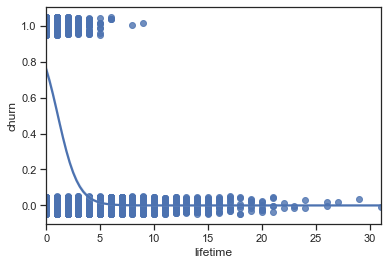

In [88]:
sns.regplot(x="lifetime", 
            y="churn", 
            data=data,
           logistic=True, n_boot=500, y_jitter=.05)
plt.show()

Здесь на графике выше мы видим, что чем больше лайфтайм, тем выше вероятность, что клиент не уйдет в отток.

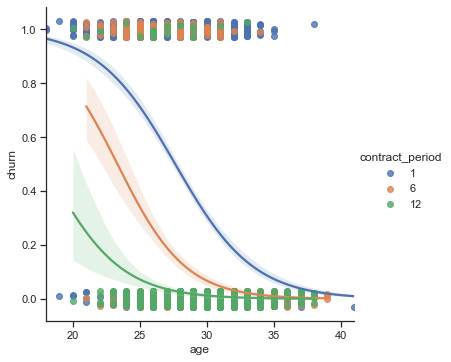

In [89]:
sns.lmplot(y="churn", x="age", hue="contract_period", data=data, 
           logistic=True, n_boot=500, y_jitter=.03)
plt.show()

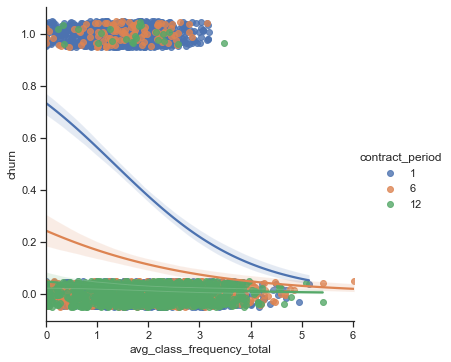

In [90]:
sns.lmplot(y="churn", x="avg_class_frequency_total", hue="contract_period", data=data, 
           logistic=True, n_boot=500, y_jitter=.05)
plt.show()

Здесь можно сделать вывод, что чем больше частота посещений, тем выше вероятность не уйти в отток, причем для длительных абонементов не характерно уходить в отток.

Из зависимости по возрасту можно сказать, что низкий отток характернее для более взрослых клиентов, и такая же тенденция для длительности абонемента.

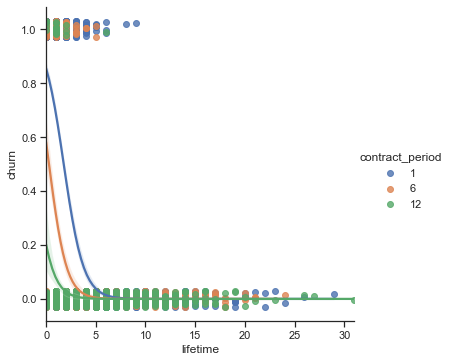

In [91]:
sns.lmplot(y="churn", x="lifetime", data=data, hue='contract_period',
           logistic=True, n_boot=500, y_jitter=.03
          )
plt.show()

In [92]:
lr_model.coef_

array([[ 0.04784733,  0.0938597 , -0.3213478 ,  0.47165011, -0.1930009 ,
        -0.70669926, -0.19640392, -0.00485756, -0.08091826, -0.90791455,
         3.23966627, -3.89102232]])

In [93]:
X_train.columns

Index(['gender', 'near_location', 'promo_friends', 'phone', 'contract_period',
       'group_visits', 'age', 'avg_additional_charges_total',
       'month_to_end_contract', 'lifetime', 'avg_class_frequency_total',
       'avg_class_frequency_current_month'],
      dtype='object')

In [94]:
 lr_model.intercept_

array([8.38792261])

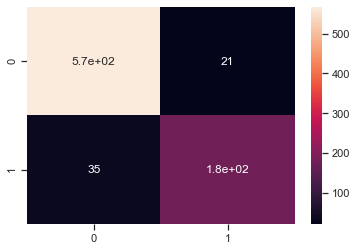

In [95]:
cm = confusion_matrix(y_test, lr_predictions)
sns.heatmap(cm, annot=True)
plt.show()

Итак, модель логистической регрессии построена.

#### Модель случайного леса

Зададим алгоритм для новой модели на основе алгоритма случайного леса:

In [96]:
rf_model =  RandomForestClassifier(n_estimators=100, random_state=0)

Обучим модель случайного леса:

In [97]:
rf_model.fit(X_train, y_train)

RandomForestClassifier(random_state=0)

Воспользуемся обученной моделью, чтобы сделать прогнозы:

In [98]:
rf_predictions = rf_model.predict(X_test)
rf_probabilities = rf_model.predict_proba(X_test)[:, 1]

<Figure size 1800x1440 with 0 Axes>

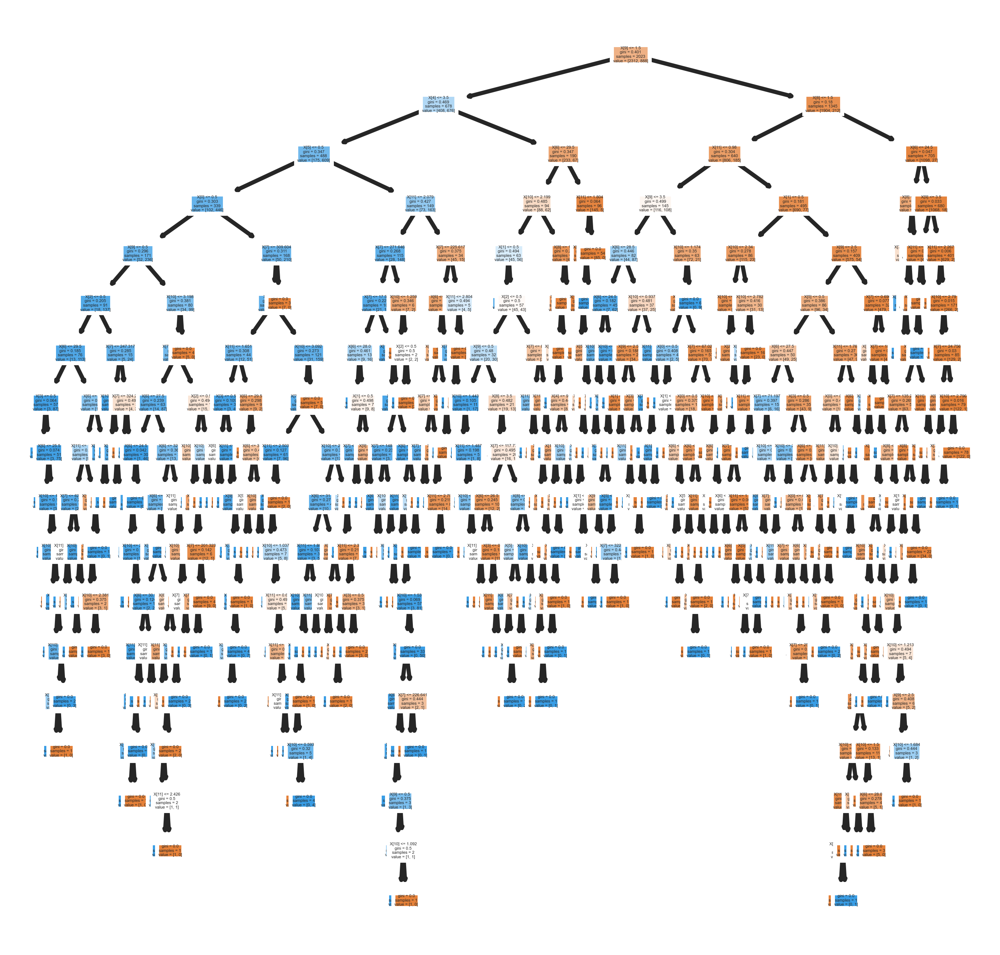

In [99]:
fig = plt.figure(figsize=(25,20))
#fn=data.feature_names
#cn=data.target_names
fig, axes = plt.subplots(nrows = 1,
                         ncols = 1,
                         figsize = (4,4), 
                         dpi=800)

plot_tree(rf_model.estimators_[0],
               #feature_names = fn, 
               #class_names=cn,
               filled = True);

#fig.savefig('rf_individualtree.png')
plt.show()

In [100]:
# This may not the best way to view each estimator as it is small
#fn=data.feature_names
#cn=data.target_names
fig, axes = plt.subplots(nrows = 1,ncols = 4,figsize = (20,10), dpi=900)
for index in range(0, 4):
    plot_tree(rf_model.estimators_[index],
                   #feature_names = fn, 
                   #class_names=cn,
                   filled = True,
                   ax = axes[index]);

    axes[index].set_title('Estimator: ' + str(index), fontsize = 11)
#plt.show()
#fig.savefig('rf_5trees.png')

Итак, модель случайного леса построена.

### Оценка метрик моделей и сравнение моделей

Зададим функцию для расчета необходимых метрик.

In [119]:
def print_all_metrics(y_true, y_pred, y_proba, title='Метрики классификации'):
    print(title)
    print('\tAccuracy: {:.2f}'.format(accuracy_score(y_true, y_pred)))
    print('\tPrecision: {:.2f}'.format(precision_score(y_true, y_pred)))
    print('\tRecall: {:.2f}'.format(recall_score(y_true, y_pred)))
    print('\tF1: {:.2f}'.format(f1_score(y_true, y_pred)))
    print('\tROC_AUC: {:.2f}'.format(roc_auc_score(y_true, y_proba)))

Оптимизация кода с помощью функций позволяет сделать сам проект еще более читабельньным.

In [120]:
print_all_metrics(
    y_test,
    lr_predictions,
    lr_probabilities,
    title='Метрики для модели логистической регрессии:',
)

Метрики для модели логистической регрессии:
	Accuracy: 0.93
	Precision: 0.89
	Recall: 0.83
	F1: 0.86
	ROC_AUC: 0.98


In [121]:
print_all_metrics(
    y_test,
    rf_predictions,
    rf_probabilities, 
    title='Метрики для модели случайного леса:'
)

Метрики для модели случайного леса:
	Accuracy: 0.92
	Precision: 0.89
	Recall: 0.81
	F1: 0.85
	ROC_AUC: 0.97


Оценка метрик показала, что показатели логистической регресии в целом немного лучше. Выше такие метрики как Precision, Recall, F1.

Визуализируем метрику ROC с помощью построения кривой:

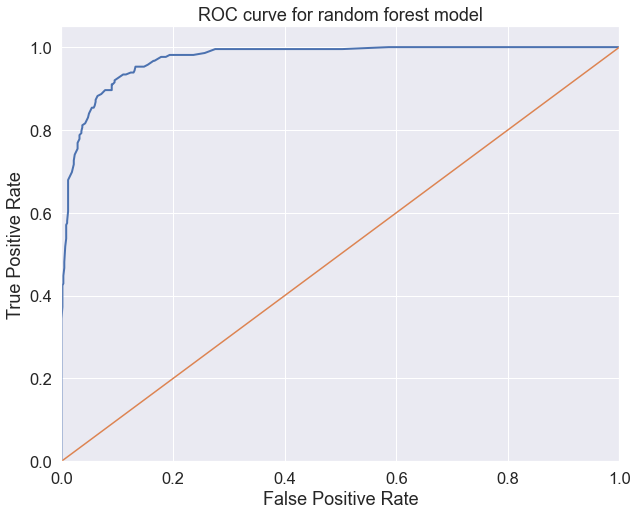

In [122]:
sns.set(font_scale=1.5)
sns.set_color_codes("muted")

plt.figure(figsize=(10, 8))
fpr, tpr, thresholds = roc_curve(y_test, rf_model.predict_proba(X_test)[:,1], pos_label=1)
lw = 2
plt.plot(fpr, tpr, lw=lw, label='ROC curve ')
plt.plot([0, 1], [0, 1])
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curve for random forest model')
plt.savefig("ROC.png")
plt.show()

In [123]:
def logloss_crutch(y_true, y_pred, eps=1e-15):

    return - (y_true * np.log(y_pred) + (1 - y_true) * np.log(1 - y_pred))

print('Logloss при неуверенной классификации %f' % logloss_crutch(1, 0.5))
#>> Logloss при неуверенной классификации 0.693147

print('Logloss при уверенной классификации и верном ответе %f' % logloss_crutch(1, 0.9))
#>> Logloss при уверенной классификации и верном ответе 0.105361

print('Logloss при уверенной классификации и НЕверном ответе %f' % logloss_crutch(1, 0.1))
#>> Logloss при уверенной классификации и НЕверном ответе 2.302585

Logloss при неуверенной классификации 0.693147
Logloss при уверенной классификации и верном ответе 0.105361
Logloss при уверенной классификации и НЕверном ответе 2.302585


## Кластеризация клиентов

### Стандартизация данных

Сначала создадим объект класса Scaler (нормализатор), затем обучим нормализатор и преобразуем набор данных.

In [124]:
scaler = StandardScaler()
X_sc = scaler.fit_transform(data.drop(columns = ['churn']))

In [125]:
X_sc[:2]

array([[ 0.97970588,  0.42788074,  1.49716101, -3.05985201,  0.28989014,
         1.19403206, -0.0565538 , -1.37753121,  0.16160501, -0.19332863,
        -1.91191971, -1.67847198],
       [-1.0207145 ,  0.42788074, -0.66793083,  0.32681319,  1.60882159,
         1.19403206,  0.55732732, -0.35021325,  1.83194105,  0.87368001,
         0.04517569,  0.1360137 ]])

После преобразования данных получились их стандартизованные оценки. Далее при кластеризации будем применять их.

### Агломеративная иерархическая кластеризация

Передадим получившуюся стандартизированную таблицу в качестве параметра функции linkage(). Для вычисления расстояния между кластерами используем метод Варда.

In [126]:
linked = linkage(X_sc, method = 'ward') 

В переменной linked сохранена таблица «связок» между объектами. Её можно визуализировать как дендрограмму:

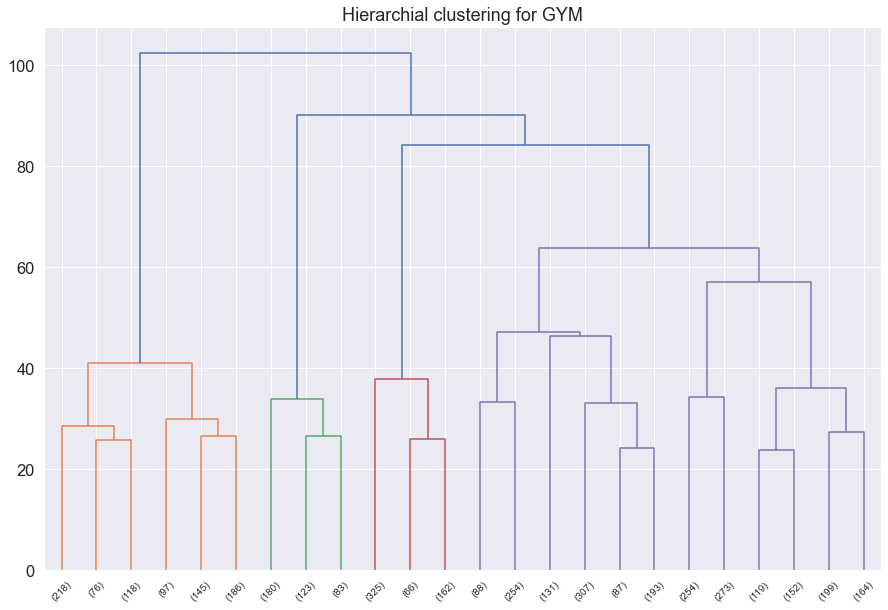

In [127]:
plt.figure(figsize=(15, 10))  
dendrogram(linked, orientation='top', truncate_mode = 'lastp', p = 24, leaf_rotation = 45)
plt.title('Hierarchial clustering for GYM')
plt.show() 

На дендрограмме четыре разных цвета, можно было бы построить четыре различных кластера по этим данным, но также возможно использование и другого количества кластеров.

В том числе чтобы определить количество кластеров можно использовать метод локтя для определения количества кластеров.

Ниже использовала байесовский информационный критерий (BIC):

In [128]:
scaler = MinMaxScaler()
X_scaled=scaler.fit_transform(X)

In [129]:
gm_bic= []
gm_score=[]
for i in range(2,12):
    gm = GaussianMixture(n_components=i,n_init=10,tol=1e-3,max_iter=1000).fit(X_sc)
    print("BIC for number of cluster(s) {}: {}".format(i,gm.bic(X_scaled)))
    print("Log-likelihood score for number of cluster(s) {}: {}".format(i,gm.score(X_sc)))
    print("-"*100)
    gm_bic.append(-gm.bic(X_sc))
    gm_score.append(gm.score(X_sc))

BIC for number of cluster(s) 2: 106478.80587782161
Log-likelihood score for number of cluster(s) 2: -9.780713417541083
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 3: 1220051291.291565
Log-likelihood score for number of cluster(s) 3: -3.761669955733973
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 4: 2899015558.008742
Log-likelihood score for number of cluster(s) 4: 2.3412920010966056
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 5: 1783880212.7076635
Log-likelihood score for number of cluster(s) 5: 4.688765172505364
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 6: 4400077852.286056
Log-likelihood score for number of cluster(s) 6: 6.949440583340683
------

Метод BIC штрафует многочисленные нормальные распределения и пытается сохранить модель достаточно простой, чтобы она описывала заданный паттерн. Следовательно, можно прогнать алгоритм GMM для большого количества кластерных центров, и значение BIC вырастет до какой-то точки, а затем начнёт снижаться по мере роста штрафа.

<ipython-input-130-9e74728aa19c>:3: RuntimeWarning: invalid value encountered in log
  plt.scatter(x=[i for i in range(2,12)],y=np.log(gm_bic),s=150,edgecolor='k')


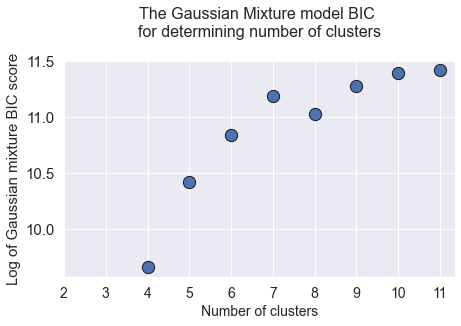

In [130]:
plt.figure(figsize=(7,4))
plt.title("The Gaussian Mixture model BIC \nfor determining number of clusters\n",fontsize=16)
plt.scatter(x=[i for i in range(2,12)],y=np.log(gm_bic),s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Number of clusters",fontsize=14)
plt.ylabel("Log of Gaussian mixture BIC score",fontsize=15)
plt.xticks([i for i in range(2,12)],fontsize=14)
plt.yticks(fontsize=15)
plt.show()

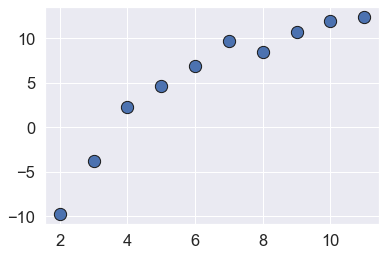

In [131]:
plt.scatter(x=[i for i in range(2,12)],y=gm_score,s=150,edgecolor='k')
plt.show()

Резкий скачок до 5-6 кластеров и говорит нам о максимальном логичном количестве в наших данных.

### Обучение модели кластеризации на основании алгоритма K-Means и прогнозирование кластеров клиентов

Зададим число кластеров, равное 5, зафиксируем значение random_state для вопроизводимости результата  и далее применим алгоритм к данным и сформируем вектор кластеров.

In [132]:
km = KMeans(n_clusters=5, random_state=0)
labels = km.fit_predict(X_sc)

In [133]:
data_cluster = data.copy()

In [134]:
data_cluster['cluster'] = labels
data_cluster.head()

,gender,near_location,promo_friends,phone,contract_period,group_visits,age,avg_additional_charges_total,month_to_end_contract,lifetime,avg_class_frequency_total,avg_class_frequency_current_month,churn,cluster
0,1,1,1,0,6,1,29,14.23,5.00,3,0.02,0.00,0,3
1,0,1,0,1,12,1,31,113.20,12.00,7,1.92,1.91,0,2
2,0,1,0,1,1,0,28,129.45,1.00,2,1.86,1.74,0,4
3,0,1,1,1,12,1,33,62.67,12.00,2,3.21,3.36,0,2
4,1,1,1,1,1,0,26,198.36,1.00,3,1.11,1.12,0,0


In [135]:
clusters = data_cluster.groupby(['cluster']).mean()
clusters.T

cluster,0,1,2,3,4
gender,1.00,0.58,0.49,0.52,0.00
near_location,0.78,0.86,0.94,0.86,0.79
promo_friends,0.23,0.25,0.53,0.31,0.21
phone,1.00,1.00,1.00,0.00,1.00
contract_period,2.10,2.78,11.34,4.79,2.04
group_visits,0.32,0.45,0.56,0.43,0.30
age,28.18,30.29,29.91,29.30,28.35
avg_additional_charges_total,130.67,164.80,163.60,143.96,130.51
month_to_end_contract,1.99,2.56,10.37,4.48,1.92
lifetime,2.48,4.90,4.89,3.92,2.58


Теперь у нас есть портреты наших пользователей.

Сразу можно сказать, что в первый кластер попали только мужчины (1 - М), в пятый кластер - только женщины (0 - Ж). В четвертом кластере собрались клиенты, которые не указали номер телефона (отток по кластеру 0.27). Период действия абонемента выше в третьем кластере, там же более высока доп. выручка, посещаемость, кол-во месяцев до завершения действия абонемента и отток. 

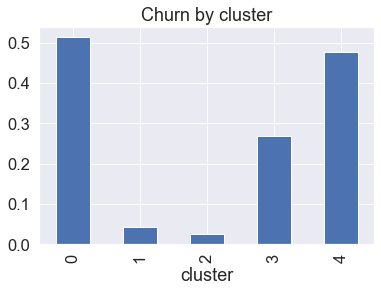

In [136]:
clusters['churn'].plot(kind='bar')
plt.title("Churn by cluster")
plt.show()

In [137]:
def plot_dist_cluster(column):
    ax = sns.displot(data=data_cluster,
                     x=column, 
                     kind="kde", 
                     height=6,
                     aspect=2,
                     hue="cluster",
                     #multiple="stack",
                     fill = True
                    )

    plt.title(f"Distribution histogram of {column.name}")
   
    plt.show()

C:\Users\Diana\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


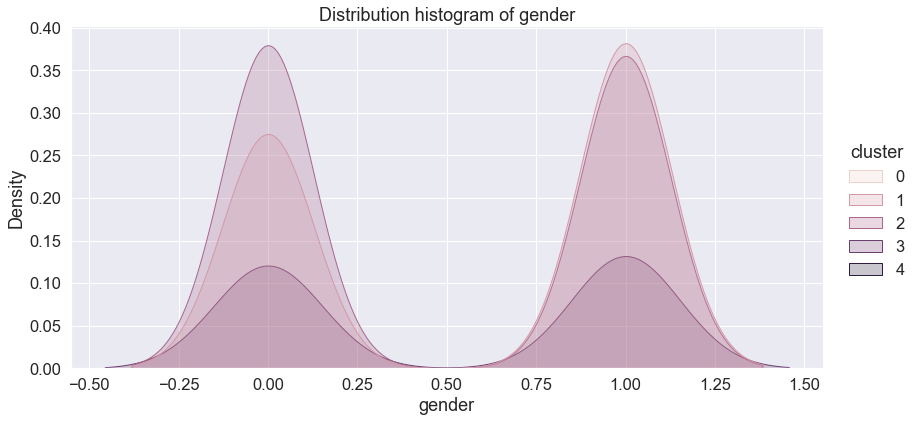

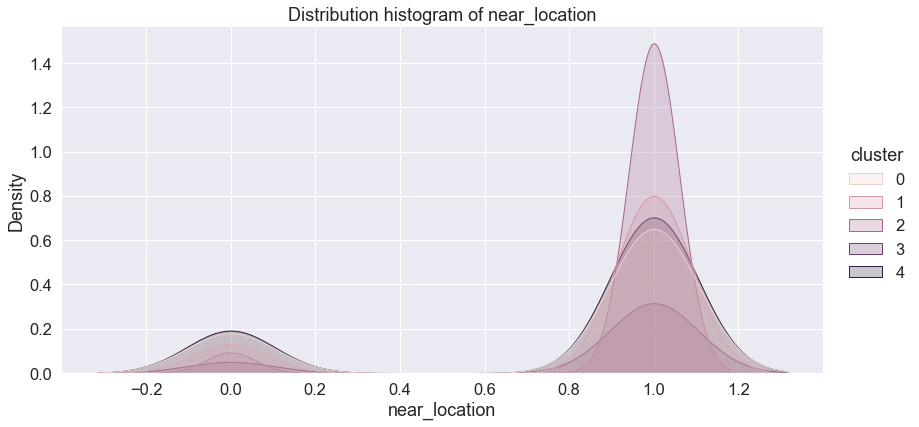

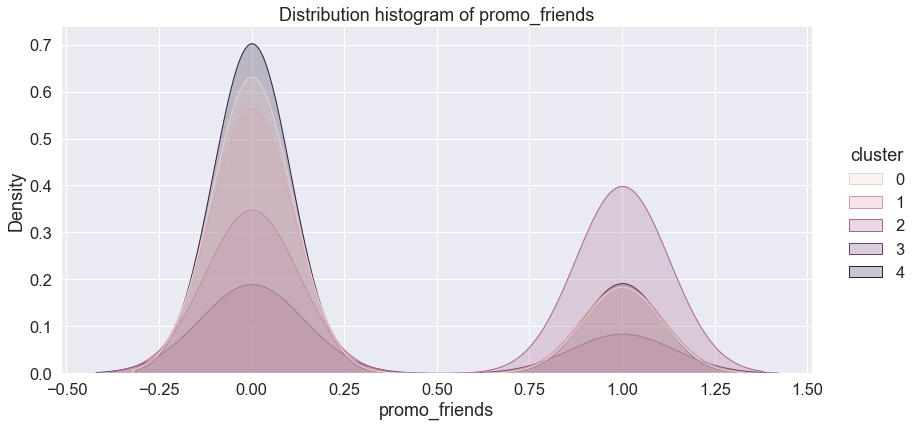

C:\Users\Diana\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


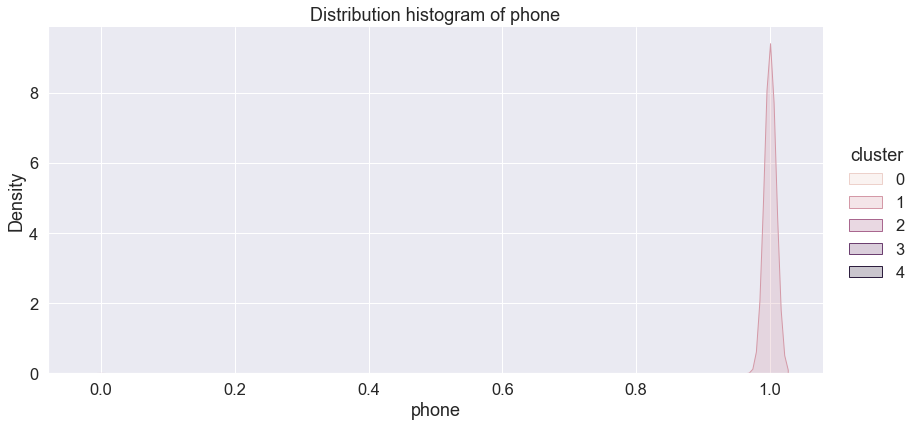

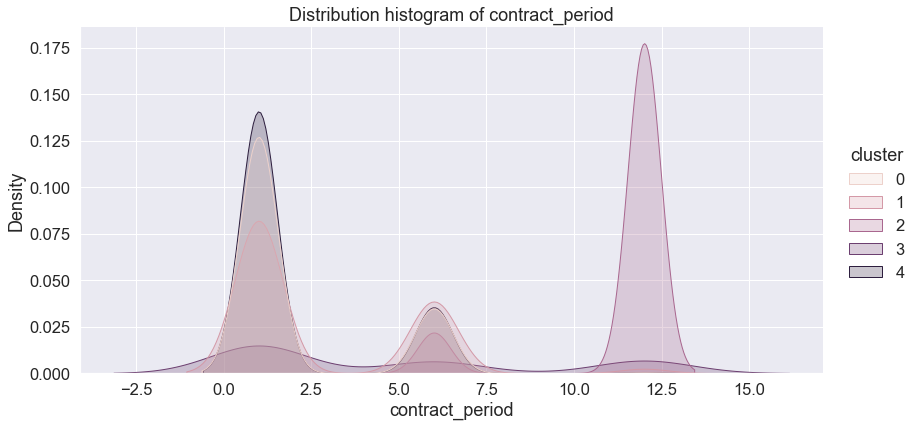

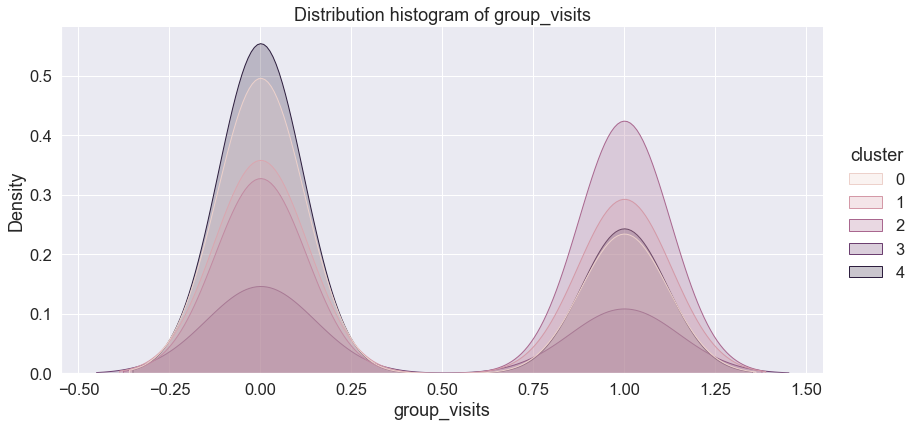

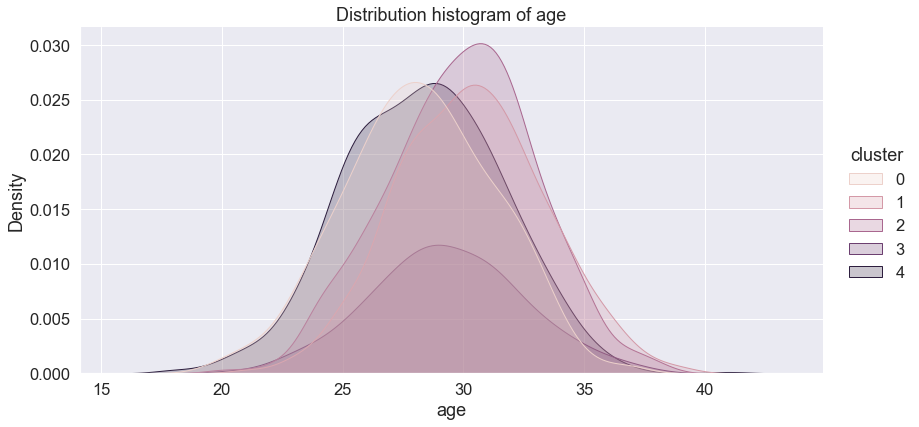

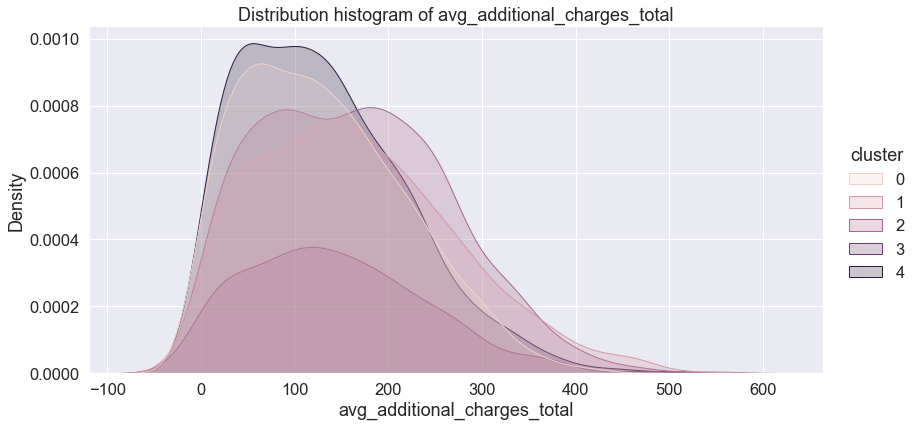

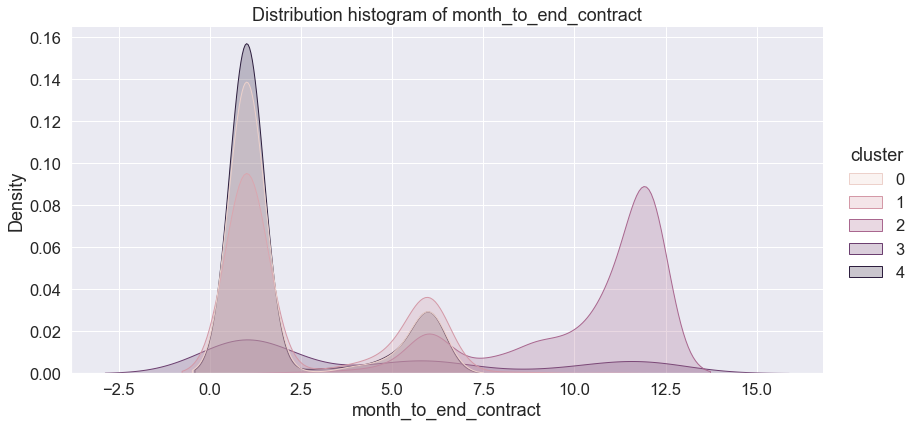

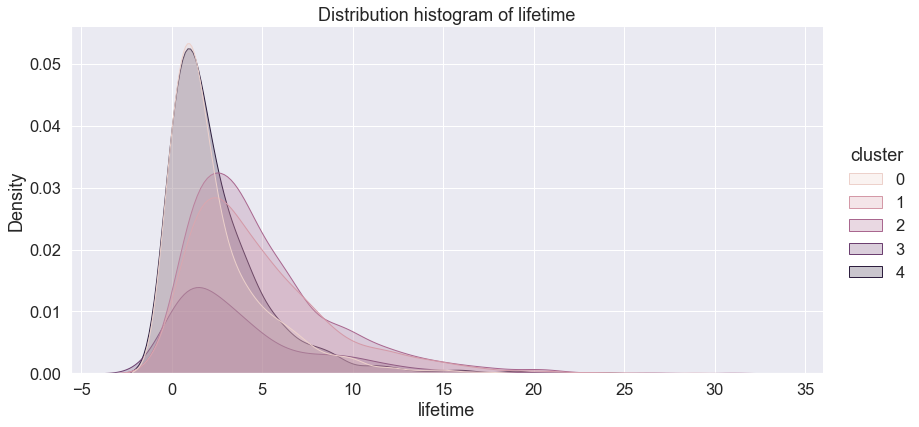

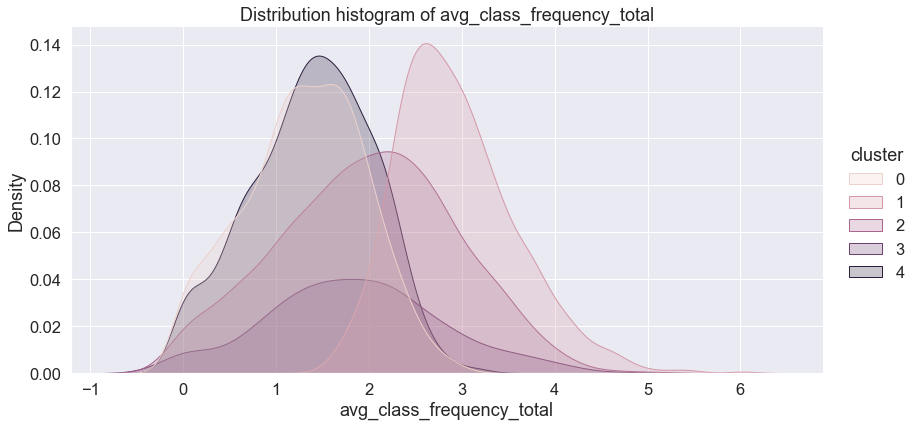

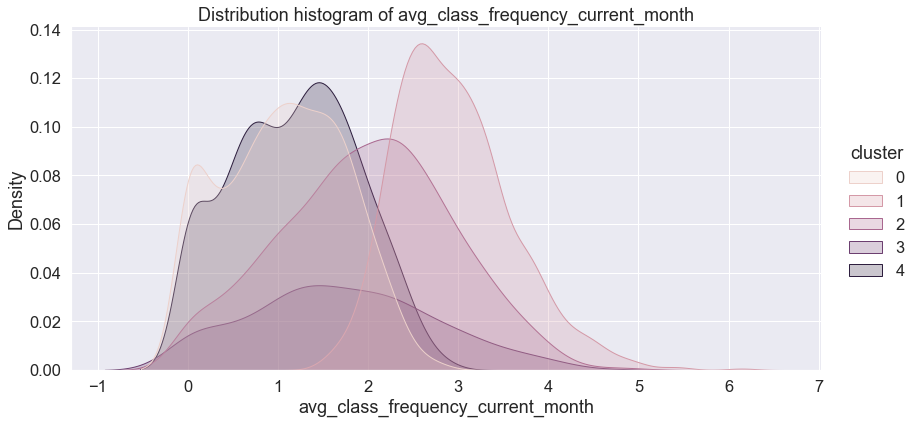

In [138]:
for col in data.columns[:-1]:
    plot_dist_cluster(data[col])

In [139]:
# определим функцию отрисовки графиков попарных признаков для кластеров
def show_clusters_on_plot(df, x_name,y_name, cluster_name):
    plt.figure(figsize = (5,5))
    sns.scatterplot(x=df[x_name], y=df[y_name],
           hue=df[cluster_name], palette='Paired'
       )
    plt.title('{} vs {}'.format(x_name, y_name))
    plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
    plt.show()

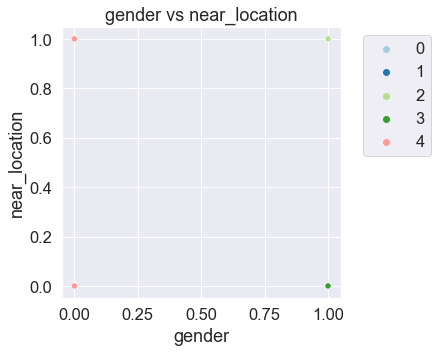

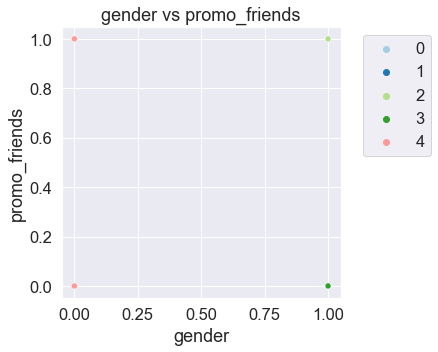

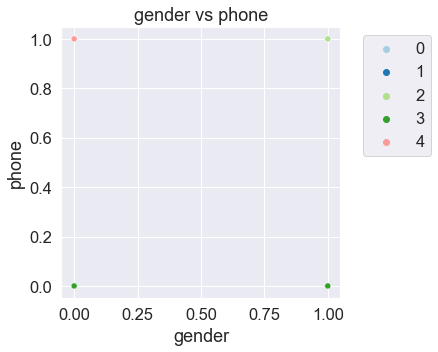

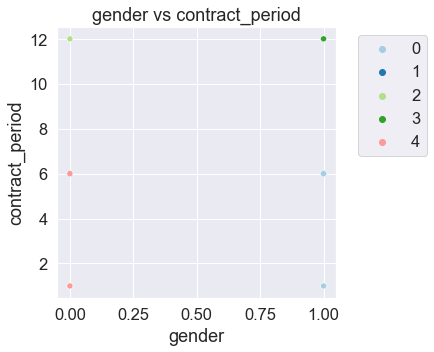

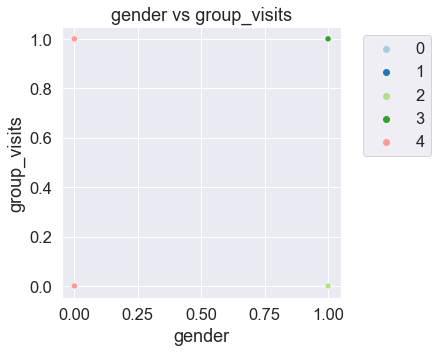

...

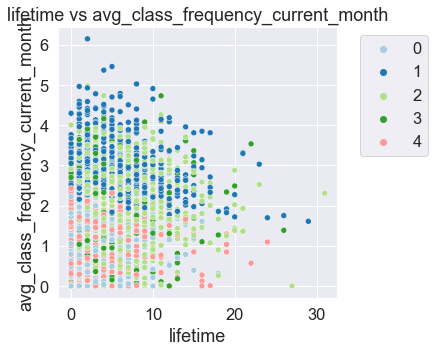

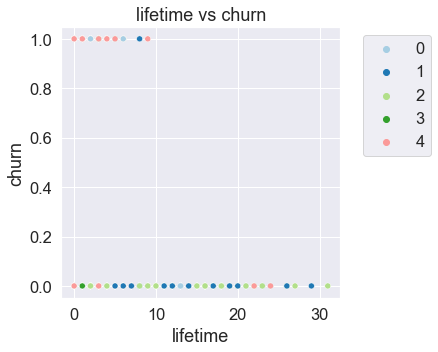

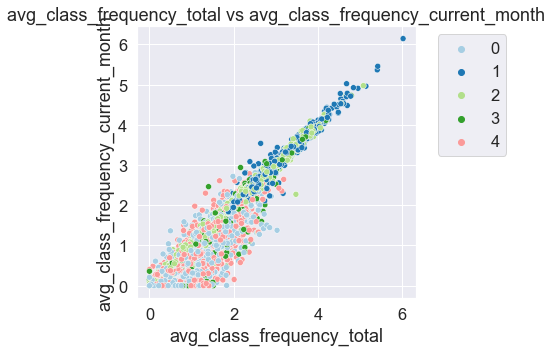

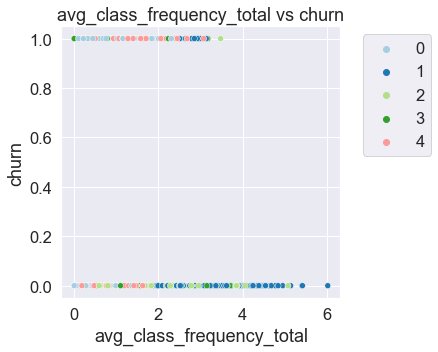

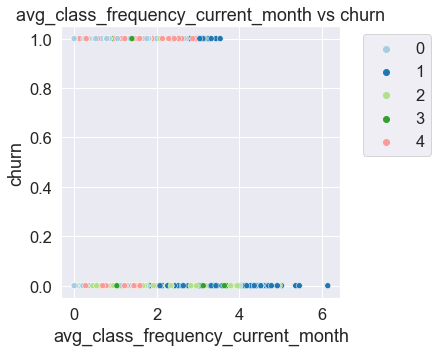

In [140]:
# отрисуем графики для попарных сочетаний признаков с разметкой по кластерам
col_pairs = list(itertools.combinations(data_cluster.drop('cluster', axis=1).columns, 2))
for pair in col_pairs:
    show_clusters_on_plot(data_cluster, pair[0], pair[1], 'cluster')

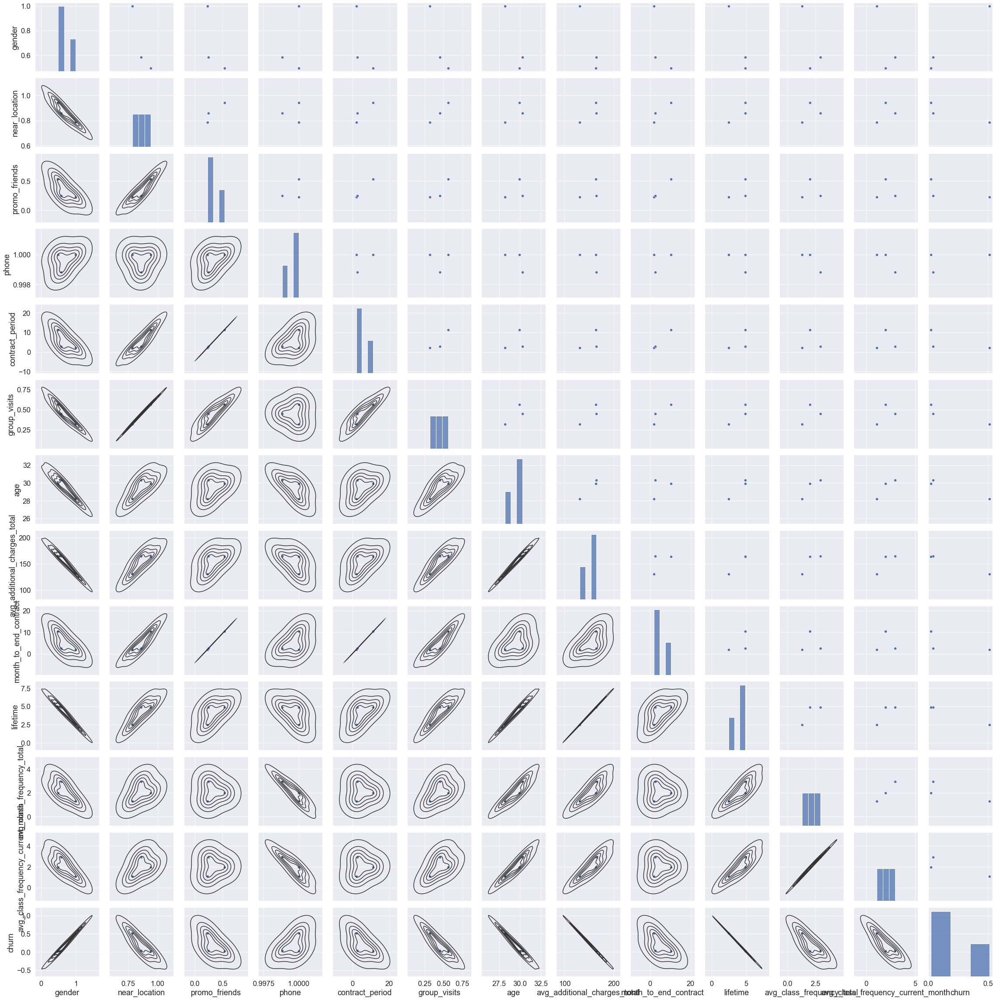

In [141]:
g = sns.pairplot(clusters[:3])
g.map_lower(sns.kdeplot, levels=6, color=".2")
plt.show()

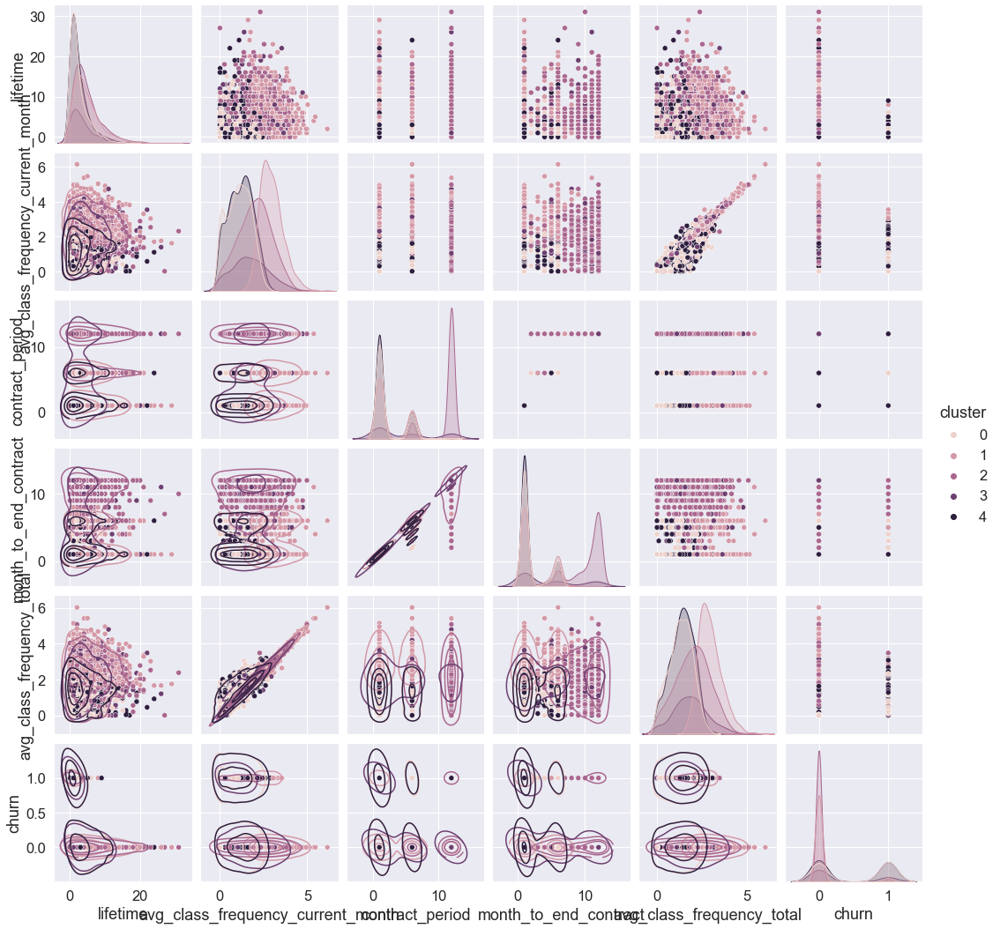

In [142]:
g = sns.pairplot(data_cluster[['lifetime', 
                   'avg_class_frequency_current_month',  
                       
                   'cluster',
                       
                   'contract_period',
                   'month_to_end_contract',
                   'avg_class_frequency_total',
                       
                   'churn']], 
                 
                 hue="cluster", diag_kind="kde")

g.map_lower(sns.kdeplot, levels=4, color=".2")
plt.show()

Описание кластеров:

* **Кластер 0**:
     * Самый высокий отток - 52%,
     * Только **мужской пол** (1),
     * Работают или живут недалеко от фитнес-клуба,
     * Приобретают в основном "короткие" абоненты,
     * Низкая посещаемость как за все время, так и за последний месяц.

**Кластер 1**
   * Отток - 4%,
   * распределение по гендеру - поровну,
   * Живут или работают недалеко от фитнес-центра
   * Самая **высокая посещаемость** - 2.94 раза в неделю,
   * Самая высокая выручка от продажи доп. услуг,
   * Абоненты сроком 2.78 в среднем (то есть не длительные)

**Кластер 2**
   * Отток - 2% - самый низкий
   * Выше всего доля пришедших по акции **"приведи друга"**
   * Преобладают сотрудники компаний-партнеров - 78%
   * Обладатели самых длительных абонементов (на 12 месяцев),
   * Самая высокая посещаемость **групповых программ**.


**Кластер 3**
   * Отток - 27%,
   * Не указали номер **мобильного телефона**,
   * длительность абонемента 4,79 - средняя,
   * лайфтайм - 3.92,
   * посещаемость средняя.

**Кластер 4**
   * Отток - 48%
   * Только **женщины** (0)
   * покупают короткие абонементы,
   * живут рядом с фитнес-центром,
   * очень похожи на кластер 0, но отличаются по полу.

Теперь у коллег из маркетинга будет много дополнительной информации, которую они смогут использовать при разработке дополнительных мероприятий по сокращению оттока.

## Выводы и рекомендации

В исследовании был проведен анализ факторов оттока клиентов из фитнес-клуба. Были показаны факторы, оказывающие наиболее сильное влияние. Прогнозирование оттока было проведено с помощью алгоритмов логистической регрессии и случайного леса (первый алгоритм показал лучший результат).

Разбиение на пять кластеров выявило разные группы клиентов. 
* Нулевой и четвертый кластер похожи, но разделены по полу. Для них возможно подойдут рекламные кампании с учетом гендерного признака, например, промо акции по женской гимнастике или мужским боевым искусствам, которые могут их привлечь.
* Самый низкий отток во втором кластере (где преобладают пришедшие по акции "приведи друга" обладатели длительных абонементов), нужно следить за уровнем их удовлетворенности, например, с помощью опросов и поддерживать лояльность, дарить скидки лояльности. Привлекать новыми видами групповых программ.
* В первом кластере тоже низкий отток, здесь любители часто тренироваться - они предпочитают тренажерный зал, а не групповые занятия. Им можно предложить индивидуальные тренировки, доп. услуги - мед. обследования, определение массовой доли жира, солярий и т.д.
* Кластер 3 покупает средней длительности абонементы и уходит в средний отток, все показатели средние и нет номера телефона. Нужно повысить доверие, проявить внимание и больше персонального подхода. Не нужно слишком много рекламы, скорее всего они не любят ее и боятся массовых рассылок.